# Импорт необходимых библиотек

In [15]:
import pandas as pd
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import warnings
from statsmodels.tsa.stattools import adfuller
import statsmodels.api as sm
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.tsa.seasonal import STL
import itertools
from math import sqrt
from sklearn.metrics import mean_squared_error
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import numpy as np

warnings.filterwarnings("ignore")

Датасет включает в себя финансовые индексы и сырьевые товары

In [2]:
df = pd.read_csv('Dataset_DiMexRank_36FinancialTimeSeries.csv')
df

,Date,NYSE,Nasdaq,SP,DJIA,Russel,TSX,IBOVES,MERVAL,WTI,...,TEPIX,BSE,CNX,HSI,SSE,Shen,TAIEX,KOSPI,NIK,ASX
0,2009-01-05,5908.430176,1628.030029,927.450012,8952.89,505.029999,9285.500000,41519,1151.800049,48.61,...,8596.4,10275.599609,3121.449951,15563.309570,1880.715942,571.133972,4698.310059,1173.569946,9043.120117,31.425200
1,2009-01-06,5968.839844,1652.380005,934.700012,9015.10,514.710022,9472.099609,42312,1214.280029,48.56,...,8596.4,10335.929688,3112.800049,15509.509766,1937.145020,586.331970,4727.259766,1194.280029,9080.839844,31.947001
2,2009-01-07,5799.049805,1599.060059,906.650024,8769.70,497.100006,9121.299805,40820,1167.060059,42.75,...,8596.4,9586.879883,2920.399902,14987.459961,1924.011963,584.705017,4789.839844,1228.170044,9239.240234,31.504000
3,2009-01-08,5837.140137,1617.010010,909.729980,8742.46,502.010010,9221.599609,41991,1192.439941,41.68,...,8596.4,9586.879883,2920.399902,14415.910156,1878.181030,573.093018,4535.790039,1205.699951,8876.419922,31.504000
4,2009-01-09,5702.370117,1571.589966,890.349976,8599.18,481.299988,9085.200195,41583,1179.550049,40.69,...,8596.4,9406.469727,2873.000000,14377.440430,1904.860962,585.851990,4502.740234,1180.959961,8836.799805,31.504000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2370,2018-02-05,12572.929688,6967.529785,2648.939941,24345.75,1491.089966,15334.799805,81861,31145.599609,64.18,...,98033.5,34757.160156,10666.549805,32245.220703,3487.497070,1806.300000,10946.250000,2491.750000,22682.080078,54.000000
2371,2018-02-06,12745.450195,7115.879883,2695.139893,24912.77,1507.170044,15363.900391,83894,31624.179688,63.48,...,97927.5,34195.941406,10498.250000,30595.419922,3370.652100,1726.090000,10404.000000,2453.310059,21610.240234,54.459999
2372,2018-02-07,12687.179688,7051.979980,2681.659912,24893.35,1507.969971,15330.599609,82767,31626.730469,61.91,...,98299.7,34082.710938,10476.700195,30323.199219,3309.260010,1714.390000,10551.540039,2396.560059,21645.369141,54.660000
2373,2018-02-08,12270.650391,6777.160156,2581.000000,23860.46,1463.790039,15065.599609,81533,31021.589844,61.30,...,98299.7,34413.160156,10576.849609,30451.269531,3262.050049,1734.570000,10528.519531,2407.620117,21890.859375,54.169998


In [3]:
df.dtypes

Date         object
NYSE        float64
Nasdaq      float64
SP          float64
DJIA        float64
Russel      float64
TSX         float64
IBOVES        int64
MERVAL      float64
WTI         float64
FTSE        float64
Euronext    float64
Eurostox    float64
CAC         float64
AEX         float64
BEL         float64
DAX         float64
SMI         float64
OMX         float64
IBEX        float64
ATX         float64
BIST        float64
JSE         float64
Brent       float64
OPEC        float64
GOLD        float64
RTS         float64
TEPIX       float64
BSE         float64
CNX         float64
HSI         float64
SSE         float64
Shen        float64
TAIEX       float64
KOSPI       float64
NIK         float64
ASX         float64
dtype: object

Приведём столбец 'Date' к формату даты и сделаем его индексом датафрейма

In [4]:
df['Date'] = pd.to_datetime(df['Date'])
df.set_index('Date', inplace=True)

In [5]:
df.isnull().sum()

NYSE        0
Nasdaq      0
SP          0
DJIA        0
Russel      0
TSX         0
IBOVES      0
MERVAL      0
WTI         0
FTSE        0
Euronext    0
Eurostox    0
CAC         0
AEX         0
BEL         0
DAX         0
SMI         0
OMX         0
IBEX        0
ATX         0
BIST        0
JSE         0
Brent       0
OPEC        0
GOLD        0
RTS         0
TEPIX       0
BSE         0
CNX         0
HSI         0
SSE         0
Shen        0
TAIEX       0
KOSPI       0
NIK         0
ASX         0
dtype: int64

In [6]:
df

,NYSE,Nasdaq,SP,DJIA,Russel,TSX,IBOVES,MERVAL,WTI,FTSE,...,TEPIX,BSE,CNX,HSI,SSE,Shen,TAIEX,KOSPI,NIK,ASX
Date,,,,,,,,,,,,,,,,,,,,,
2009-01-05,5908.430176,1628.030029,927.450012,8952.89,505.029999,9285.500000,41519,1151.800049,48.61,4579.64,...,8596.4,10275.599609,3121.449951,15563.309570,1880.715942,571.133972,4698.310059,1173.569946,9043.120117,31.425200
2009-01-06,5968.839844,1652.380005,934.700012,9015.10,514.710022,9472.099609,42312,1214.280029,48.56,4638.92,...,8596.4,10335.929688,3112.800049,15509.509766,1937.145020,586.331970,4727.259766,1194.280029,9080.839844,31.947001
2009-01-07,5799.049805,1599.060059,906.650024,8769.70,497.100006,9121.299805,40820,1167.060059,42.75,4507.51,...,8596.4,9586.879883,2920.399902,14987.459961,1924.011963,584.705017,4789.839844,1228.170044,9239.240234,31.504000
2009-01-08,5837.140137,1617.010010,909.729980,8742.46,502.010010,9221.599609,41991,1192.439941,41.68,4505.37,...,8596.4,9586.879883,2920.399902,14415.910156,1878.181030,573.093018,4535.790039,1205.699951,8876.419922,31.504000
2009-01-09,5702.370117,1571.589966,890.349976,8599.18,481.299988,9085.200195,41583,1179.550049,40.69,4448.54,...,8596.4,9406.469727,2873.000000,14377.440430,1904.860962,585.851990,4502.740234,1180.959961,8836.799805,31.504000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-02-05,12572.929688,6967.529785,2648.939941,24345.75,1491.089966,15334.799805,81861,31145.599609,64.18,7334.98,...,98033.5,34757.160156,10666.549805,32245.220703,3487.497070,1806.300000,10946.250000,2491.750000,22682.080078,54.000000
2018-02-06,12745.450195,7115.879883,2695.139893,24912.77,1507.170044,15363.900391,83894,31624.179688,63.48,7141.40,...,97927.5,34195.941406,10498.250000,30595.419922,3370.652100,1726.090000,10404.000000,2453.310059,21610.240234,54.459999
2018-02-07,12687.179688,7051.979980,2681.659912,24893.35,1507.969971,15330.599609,82767,31626.730469,61.91,7279.42,...,98299.7,34082.710938,10476.700195,30323.199219,3309.260010,1714.390000,10551.540039,2396.560059,21645.369141,54.660000


# Проверка на стационарность с помощью Дики-Фуллера и скользящей средней

Здесь чётко прослеживается что все временные ряды являются нестационарными, так как ADF статистика меньше критического значения(5%), следовательно нулевая гипотеза может быть отвергнута. Это может означать, что временные ряды не является стационарным и имеет единичный корень. Также на графиках прослеживается, что скользящие среднее и скользящая вариация изменяция со временем, что тоже свидетельствует о нестационарности рядов. Попробуем, в дальнейшем, сделать их стационарными, чтобы построить на них модели прогнозирования.

ADF Statistic for NYSE: -1.0579243834024474
p-value: 0.7315563524958291
Critical Values:
   1%: -3.433108696945792
   5%: -2.8627587489885524
   10%: -2.5674187921338687
Ряд нестационарен


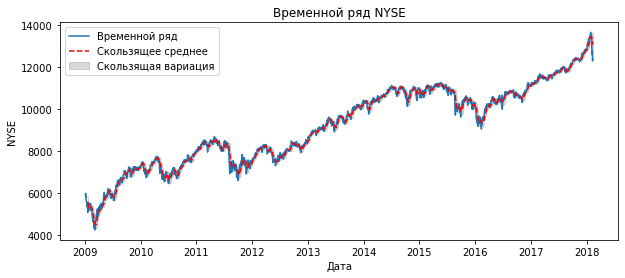

ADF Statistic for Nasdaq: 0.21172580524199353
p-value: 0.972911643194998
Critical Values:
   1%: -3.433107533639768
   5%: -2.8627582352958174
   10%: -2.567418518633128
Ряд нестационарен


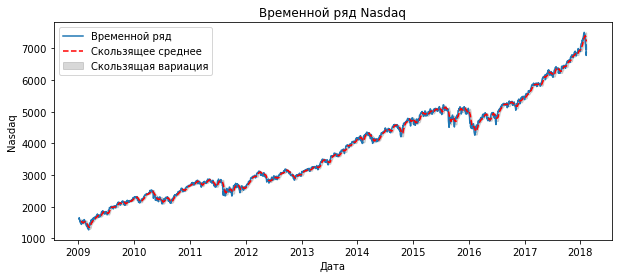

ADF Statistic for SP: -0.17503104227222696
p-value: 0.9414331428982652
Critical Values:
   1%: -3.433108696945792
   5%: -2.8627587489885524
   10%: -2.5674187921338687
Ряд нестационарен


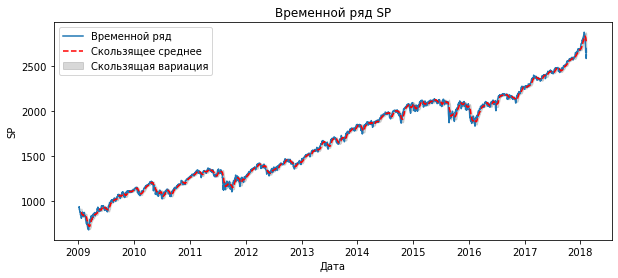

ADF Statistic for DJIA: 0.21894219483445987
p-value: 0.9733042152555601
Critical Values:
   1%: -3.433113360001643
   5%: -2.862760808098992
   10%: -2.567419888447605
Ряд нестационарен


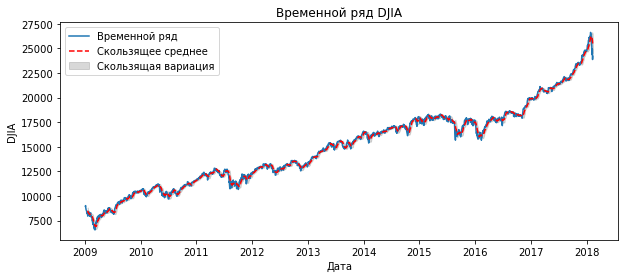

ADF Statistic for Russel: -0.8746092239509601
p-value: 0.7962189408060656
Critical Values:
   1%: -3.433113360001643
   5%: -2.862760808098992
   10%: -2.567419888447605
Ряд нестационарен


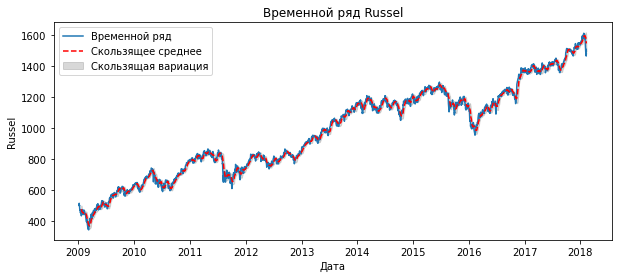

ADF Statistic for TSX: -2.4227498820732243
p-value: 0.1354180978678915
Critical Values:
   1%: -3.4331156974460857
   5%: -2.862761840265617
   10%: -2.5674204379950414
Ряд нестационарен


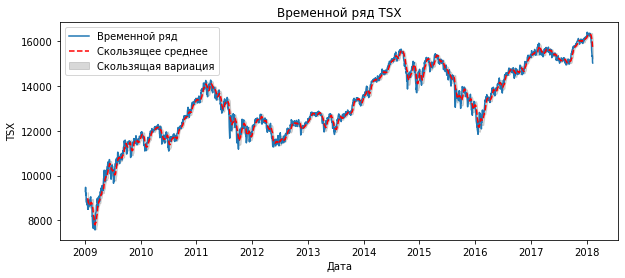

ADF Statistic for IBOVES: -1.7491918148274903
p-value: 0.4059620099207373
Critical Values:
   1%: -3.433108696945792
   5%: -2.8627587489885524
   10%: -2.5674187921338687
Ряд нестационарен


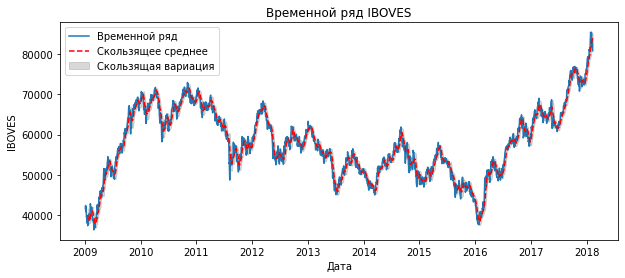

ADF Statistic for MERVAL: 1.824033923633193
p-value: 0.9983955120954524
Critical Values:
   1%: -3.433128624404979
   5%: -2.8627675485259805
   10%: -2.5674234771965376
Ряд нестационарен


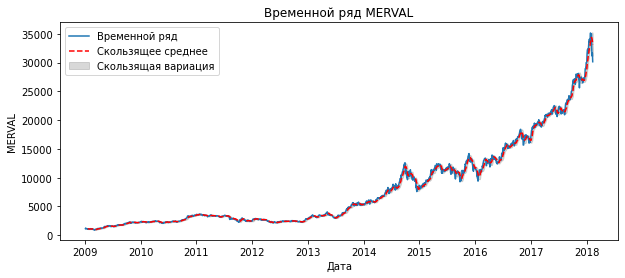

ADF Statistic for WTI: -1.6351904287163141
p-value: 0.4647750226023454
Critical Values:
   1%: -3.433107533639768
   5%: -2.8627582352958174
   10%: -2.567418518633128
Ряд нестационарен


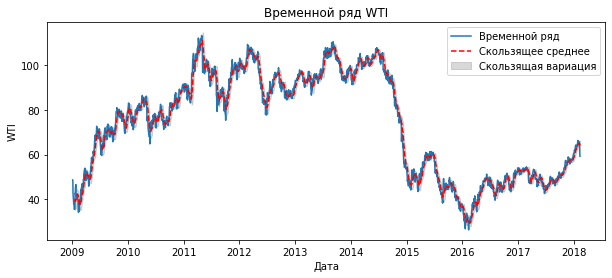

ADF Statistic for FTSE: -1.9687981798121144
p-value: 0.3004193047534719
Critical Values:
   1%: -3.433107533639768
   5%: -2.8627582352958174
   10%: -2.567418518633128
Ряд нестационарен


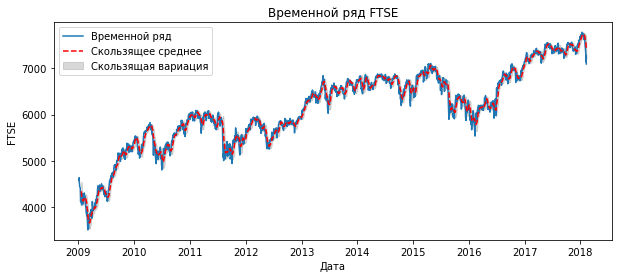

ADF Statistic for Euronext: -1.3140627671734404
p-value: 0.6227142748849335
Critical Values:
   1%: -3.433114528229779
   5%: -2.8627613239642278
   10%: -2.5674201631051976
Ряд нестационарен


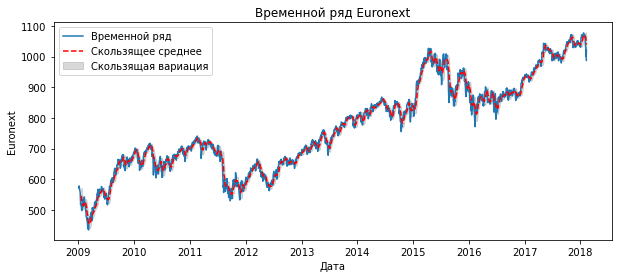

ADF Statistic for Eurostox: -2.068152725841674
p-value: 0.2575118144965247
Critical Values:
   1%: -3.433114528229779
   5%: -2.8627613239642278
   10%: -2.5674201631051976
Ряд нестационарен


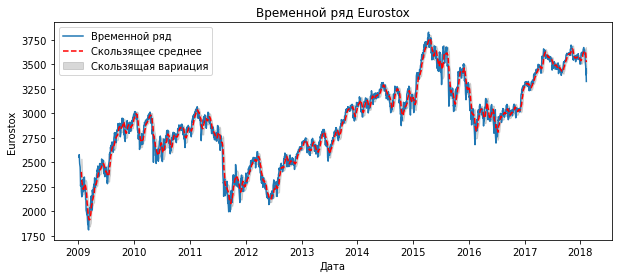

ADF Statistic for CAC: -1.6863399058850899
p-value: 0.4381639545634741
Critical Values:
   1%: -3.433107533639768
   5%: -2.8627582352958174
   10%: -2.567418518633128
Ряд нестационарен


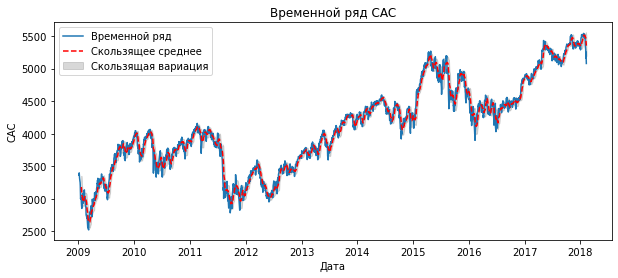

ADF Statistic for AEX: -1.2050644948879308
p-value: 0.6714133084086212
Critical Values:
   1%: -3.433108696945792
   5%: -2.8627587489885524
   10%: -2.5674187921338687
Ряд нестационарен


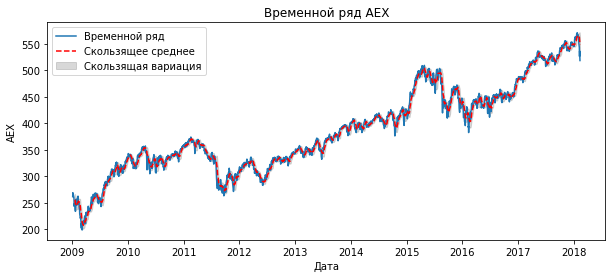

ADF Statistic for BEL: -1.0312061503089531
p-value: 0.741713134866259
Critical Values:
   1%: -3.433113360001643
   5%: -2.862760808098992
   10%: -2.567419888447605
Ряд нестационарен


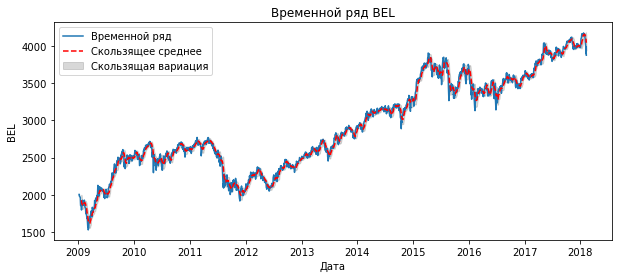

ADF Statistic for DAX: -0.9994109930422834
p-value: 0.7534790673248222
Critical Values:
   1%: -3.433107533639768
   5%: -2.8627582352958174
   10%: -2.567418518633128
Ряд нестационарен


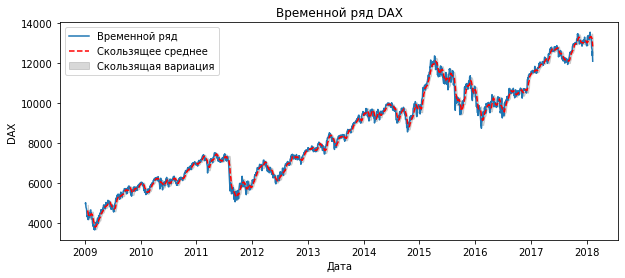

ADF Statistic for SMI: -1.4954392765332982
p-value: 0.5357662450430949
Critical Values:
   1%: -3.433113360001643
   5%: -2.862760808098992
   10%: -2.567419888447605
Ряд нестационарен


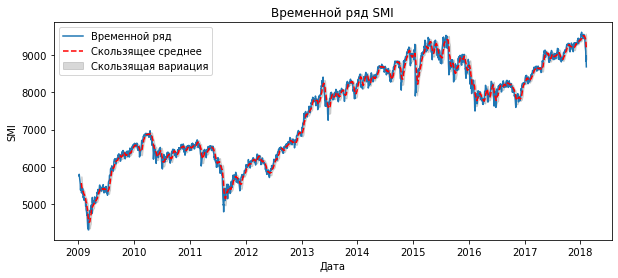

ADF Statistic for OMX: -1.9225357235348026
p-value: 0.32153498194007046
Critical Values:
   1%: -3.433113360001643
   5%: -2.862760808098992
   10%: -2.567419888447605
Ряд нестационарен


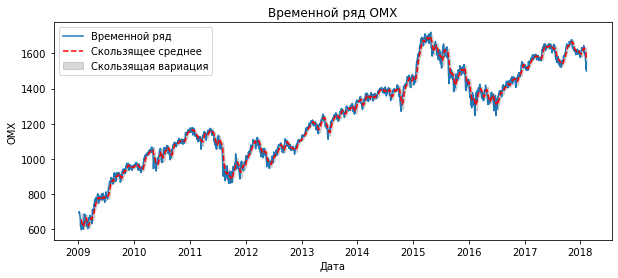

ADF Statistic for IBEX: -2.4883666574273606
p-value: 0.11833056174020118
Critical Values:
   1%: -3.433114528229779
   5%: -2.8627613239642278
   10%: -2.5674201631051976
Ряд нестационарен


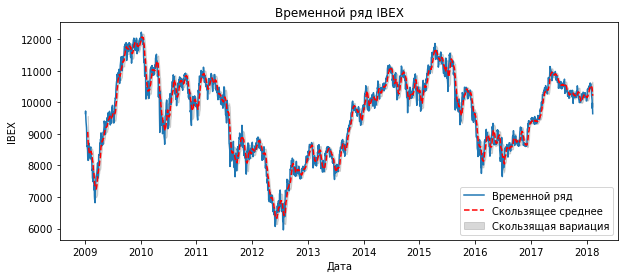

ADF Statistic for ATX: -1.552821930074132
p-value: 0.5072383027364836
Critical Values:
   1%: -3.433113360001643
   5%: -2.862760808098992
   10%: -2.567419888447605
Ряд нестационарен


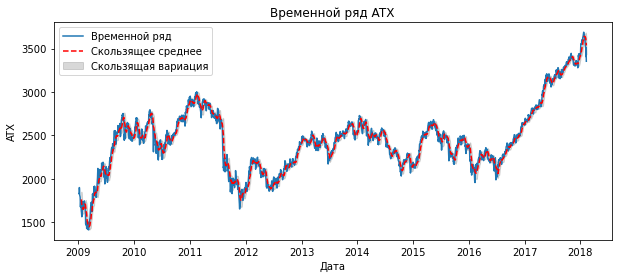

ADF Statistic for BIST: -1.5009899641887634
p-value: 0.533021561057942
Critical Values:
   1%: -3.433111026504876
   5%: -2.8627597776747735
   10%: -2.567419339827997
Ряд нестационарен


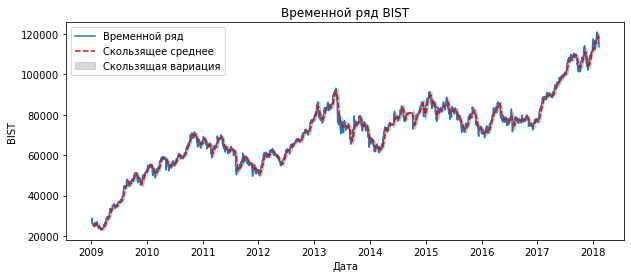

ADF Statistic for JSE: -2.48656094683884
p-value: 0.11877852678085216
Critical Values:
   1%: -3.433108696945792
   5%: -2.8627587489885524
   10%: -2.5674187921338687
Ряд нестационарен


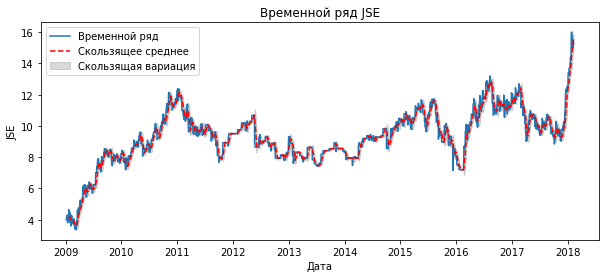

ADF Statistic for Brent: -1.4446004135267678
p-value: 0.5607173643943127
Critical Values:
   1%: -3.433107533639768
   5%: -2.8627582352958174
   10%: -2.567418518633128
Ряд нестационарен


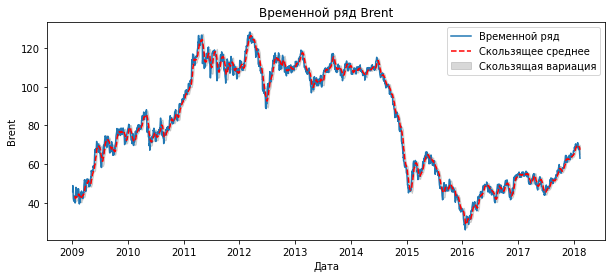

ADF Statistic for OPEC: -1.4985469704343815
p-value: 0.5342300090098505
Critical Values:
   1%: -3.433116867651817
   5%: -2.8627623570037133
   10%: -2.5674207131174307
Ряд нестационарен


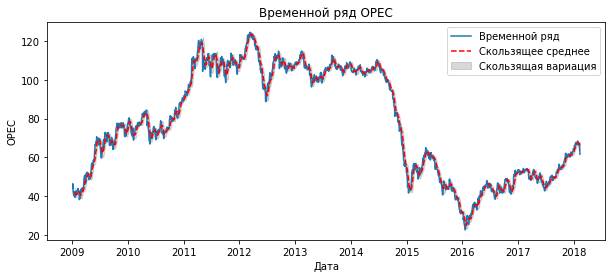

ADF Statistic for GOLD: -2.236453748441134
p-value: 0.193281793835046
Critical Values:
   1%: -3.4331262650681884
   5%: -2.8627665066966537
   10%: -2.5674229225037246
Ряд нестационарен


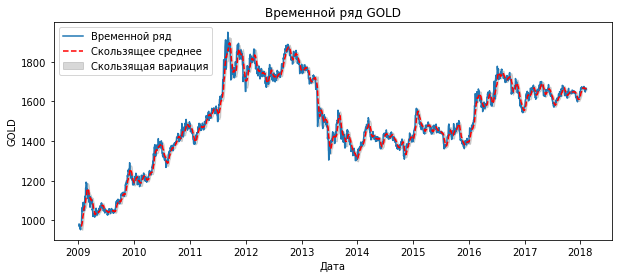

ADF Statistic for RTS: -2.309193510336429
p-value: 0.16902002347178913
Critical Values:
   1%: -3.433108696945792
   5%: -2.8627587489885524
   10%: -2.5674187921338687
Ряд нестационарен


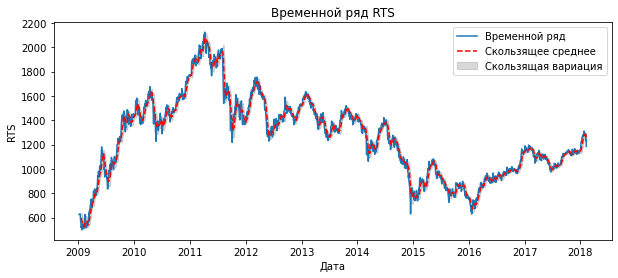

ADF Statistic for TEPIX: -0.28889328784576546
p-value: 0.9270627112706771
Critical Values:
   1%: -3.433125086901646
   5%: -2.8627659864448662
   10%: -2.5674226455102995
Ряд нестационарен


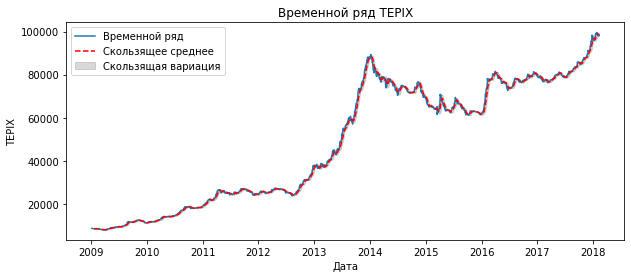

ADF Statistic for BSE: -0.8974733543557367
p-value: 0.7888033395158733
Critical Values:
   1%: -3.433108696945792
   5%: -2.8627587489885524
   10%: -2.5674187921338687
Ряд нестационарен


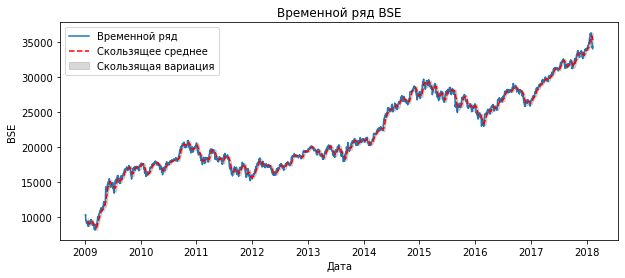

ADF Statistic for CNX: -0.7982169809748305
p-value: 0.8196452549803988
Critical Values:
   1%: -3.433108696945792
   5%: -2.8627587489885524
   10%: -2.5674187921338687
Ряд нестационарен


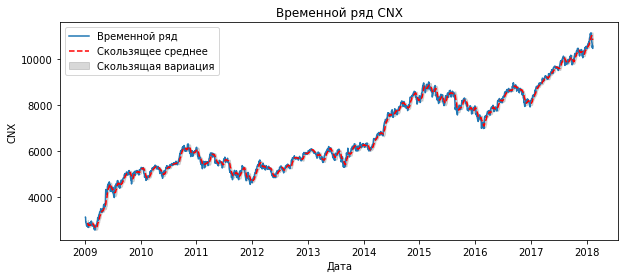

ADF Statistic for HSI: -2.1990846482031183
p-value: 0.20657784448582484
Critical Values:
   1%: -3.4331121927604253
   5%: -2.862760292669358
   10%: -2.5674196140219694
Ряд нестационарен


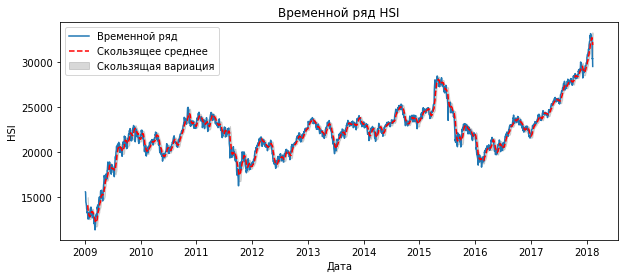

ADF Statistic for SSE: -2.2696318262982103
p-value: 0.18194940834264461
Critical Values:
   1%: -3.4331357265371256
   5%: -2.8627706846606245
   10%: -2.5674251469443186
Ряд нестационарен


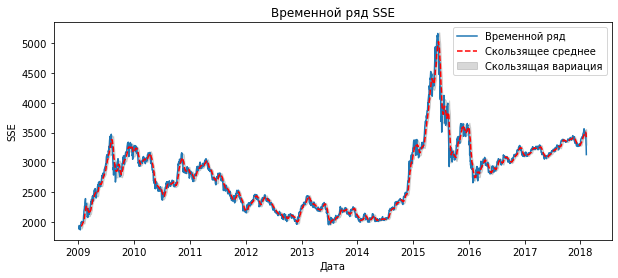

ADF Statistic for Shen: -1.8905059970844125
p-value: 0.3365404857812707
Critical Values:
   1%: -3.4331357265371256
   5%: -2.8627706846606245
   10%: -2.5674251469443186
Ряд нестационарен


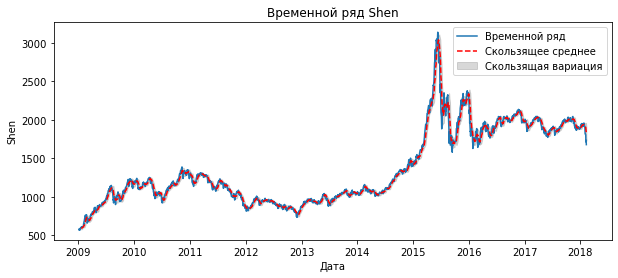

ADF Statistic for TAIEX: -3.14223973289556
p-value: 0.023581115251502947
Critical Values:
   1%: -3.4331262650681884
   5%: -2.8627665066966537
   10%: -2.5674229225037246
Ряд стационарен


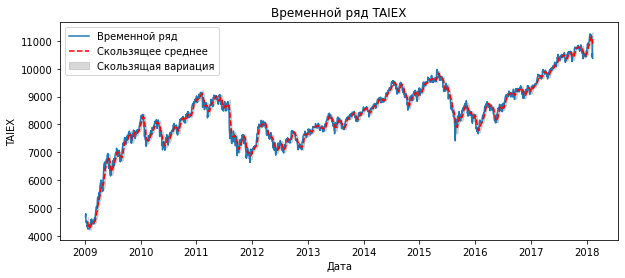

ADF Statistic for KOSPI: -2.584430774724878
p-value: 0.0962579939706939
Critical Values:
   1%: -3.4331156974460857
   5%: -2.862761840265617
   10%: -2.5674204379950414
Ряд нестационарен


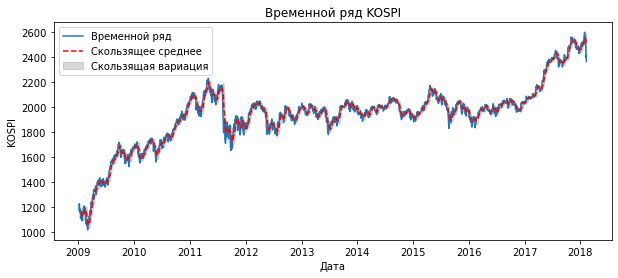

ADF Statistic for NIK: -0.5181161897772395
p-value: 0.8884324969658159
Critical Values:
   1%: -3.433108696945792
   5%: -2.8627587489885524
   10%: -2.5674187921338687
Ряд нестационарен


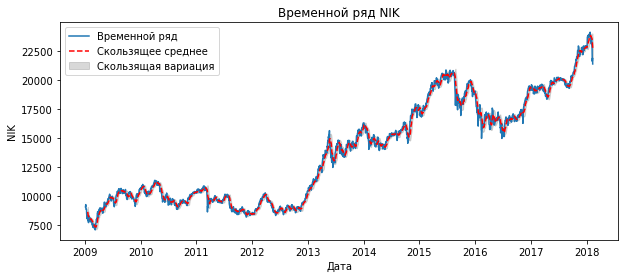

ADF Statistic for ASX: -0.6261672747111088
p-value: 0.8649590011456059
Critical Values:
   1%: -3.433107533639768
   5%: -2.8627582352958174
   10%: -2.567418518633128
Ряд нестационарен


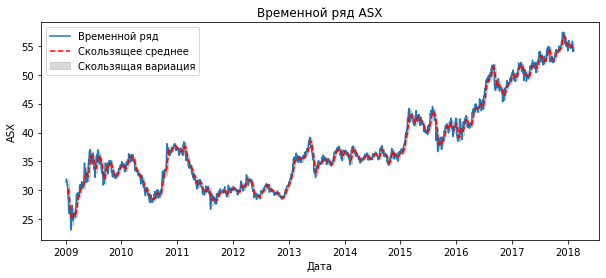

In [7]:
for column in df.columns:
    result = adfuller(df[column])
    print(f'ADF Statistic for {column}: {result[0]}')
    print(f'p-value: {result[1]}')
    print('Critical Values:')
    for key, value in result[4].items():
        print(f'   {key}: {value}')

        
    if result[1] < 0.05:
        print('Ряд стационарен')
    else:
        print('Ряд нестационарен')

    stationary_mean = df[column].rolling(window=12).mean()
    stationary_std = df[column].rolling(window=12).std()
    
    plt.figure(figsize=(10, 4))
    plt.plot(df.index, df[column], label='Временной ряд')
    plt.plot(df.index, stationary_mean, color='red', linestyle='--', label='Скользящее среднее')
    plt.fill_between(df.index, stationary_mean - stationary_std, stationary_mean + stationary_std, color='gray', alpha=0.3, label='Скользящая вариация')
    plt.xlabel('Дата')
    plt.ylabel(column)
    plt.title(f'Временной ряд {column}')
    plt.legend()
    plt.show()

Анализ временного ряда для каждого столбца в df.
Перебираем все столбцы в DataFrame df. В каждой итерации переменная column содержит имя текущего столбца.
result = adfuller(df[column]): В этой строке кода выполняется функция adfuller() для текущего столбца df[column]. adfuller() - это функция из библиотеки statsmodels, используемая для проверки стационарности временного ряда. Результат проверки сохраняется в переменную result.

Если ряд стационарен, то выводится сообщение "Ряд стационарен". В противном случае выводится сообщение "Ряд нестационарен".

stationary_mean = df[column].rolling(window=12).mean() и stationary_std = df[column].rolling(window=12).std() -  В этих строках кода вычисляются скользящее среднее и скользящее стандартное отклонение для текущего столбца с окном размером 12 (в данном случае используется окно ширины 12 месяцев).

В последующих строках кода создается график, на котором отображается временной ряд, скользящее среднее и скользящая вариация для текущего столбца. График рисуется с использованием библиотеки matplotlib.

Таким образом, данный код проходит по каждому столбцу в DataFrame df, выполняет проверку стационарности временного ряда, выводит статистические значения и графики для каждого столбца. Это позволяет проанализировать свойства и структуру временного ряда.

# Тренд, сезонность и шум

Рассмотрим основные компоненты временного ряда(тренд, сезон, остатки). Заметим, что у всех временных рядов прослеживается восходящий тренд и сезонность. Это в очередной раз подверждает, что ряды нестационарны.

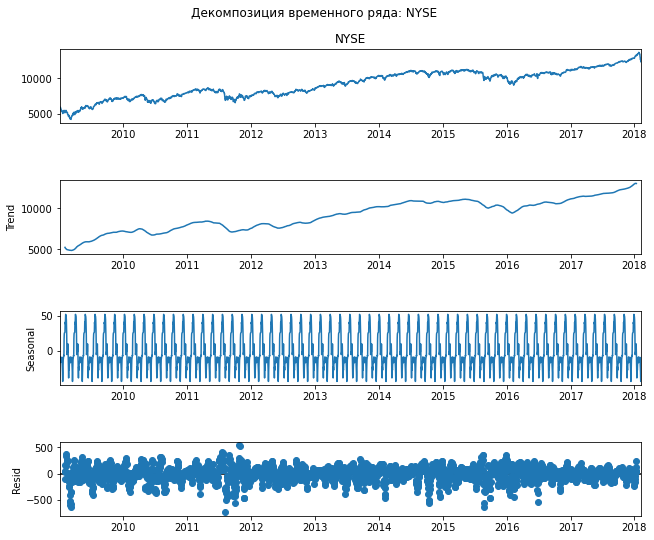

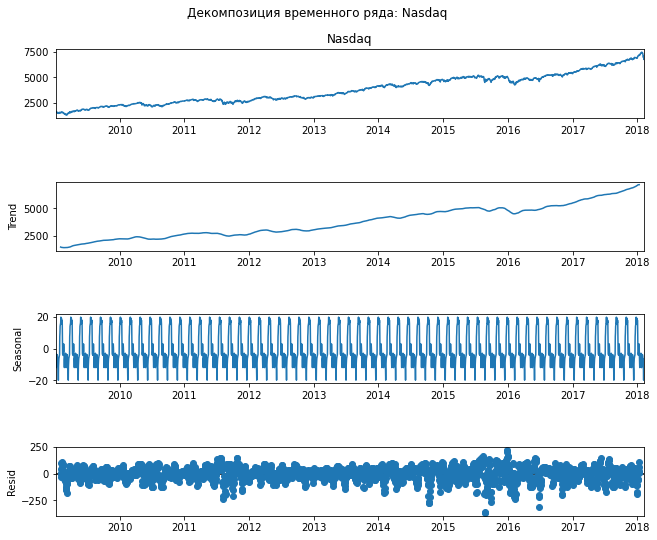

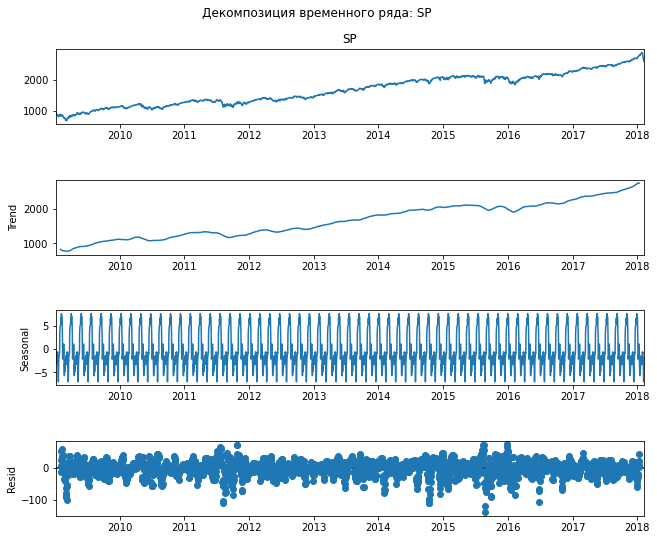

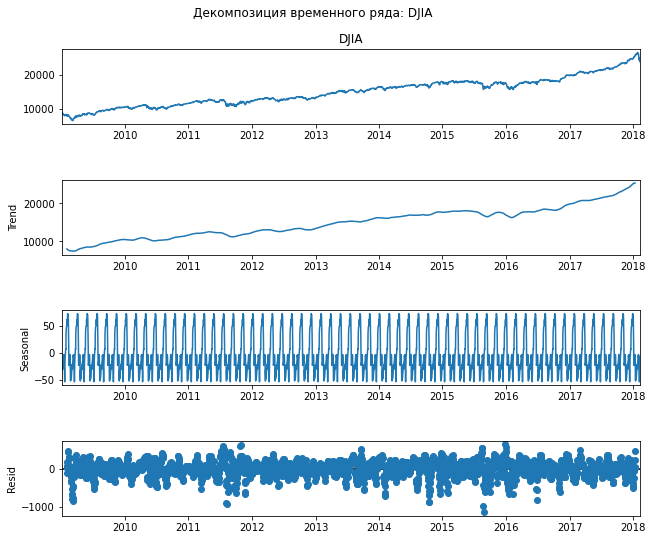

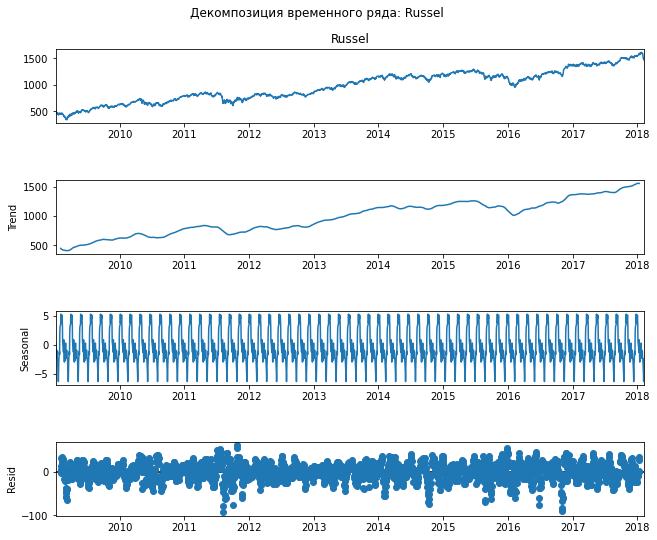

...

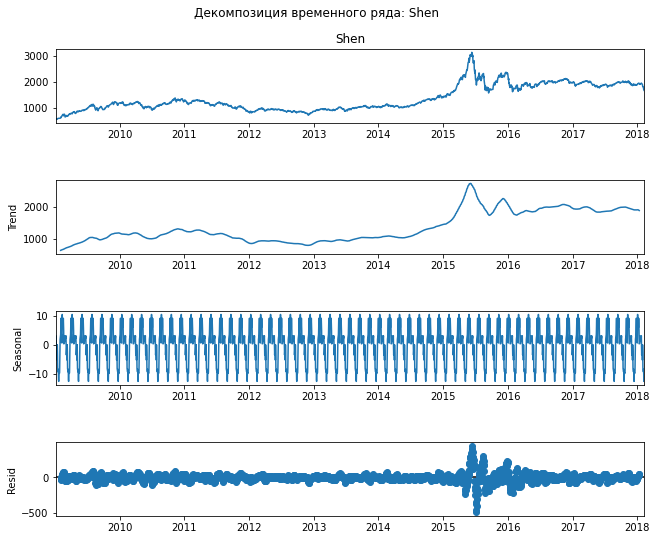

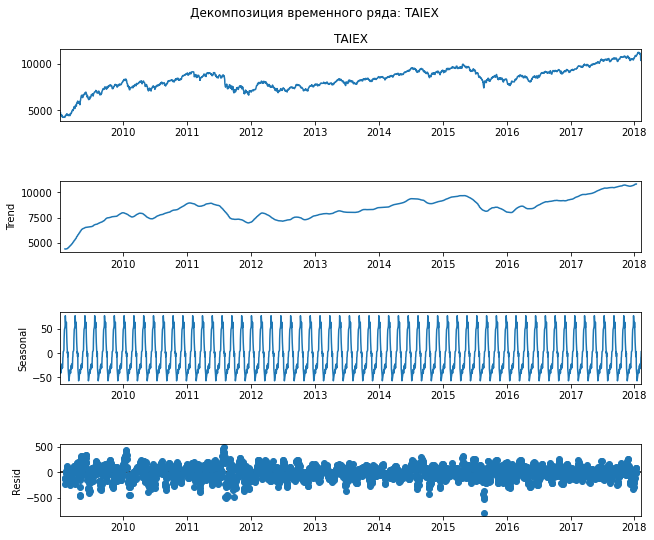

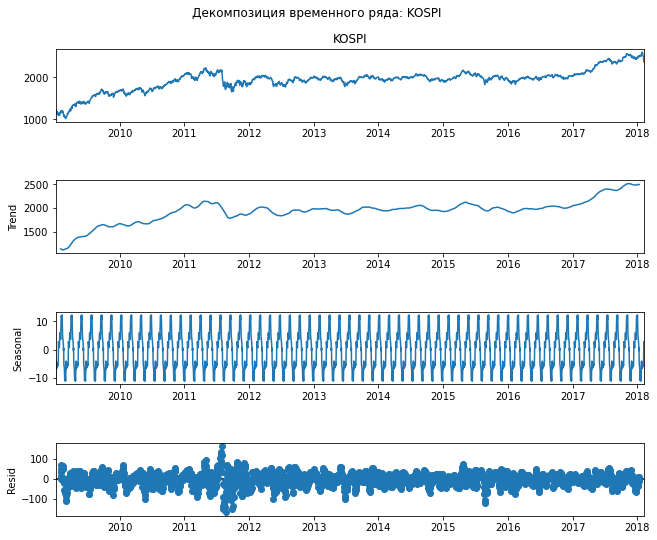

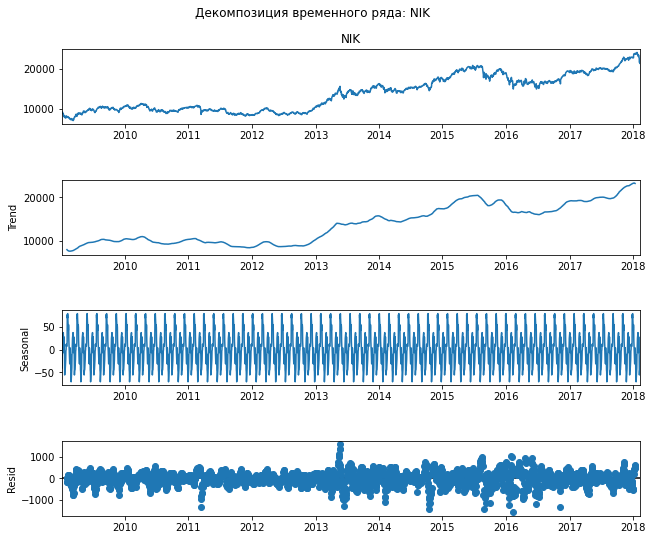

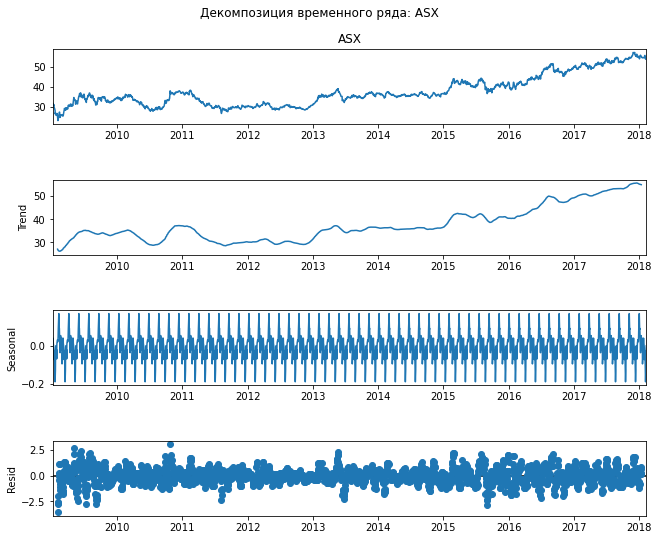

In [8]:
for column in df.columns:
    decomposition = sm.tsa.seasonal_decompose(df[column], freq=40)
    fig = decomposition.plot()
    fig.set_size_inches(10, 8)
    plt.suptitle(f"Декомпозиция временного ряда: {column}")
    plt.show()

# Двойное дифференцирование данных

Попробует преобразовать данные с помощью двойного дифференцирования, что должно сделать их стационарными

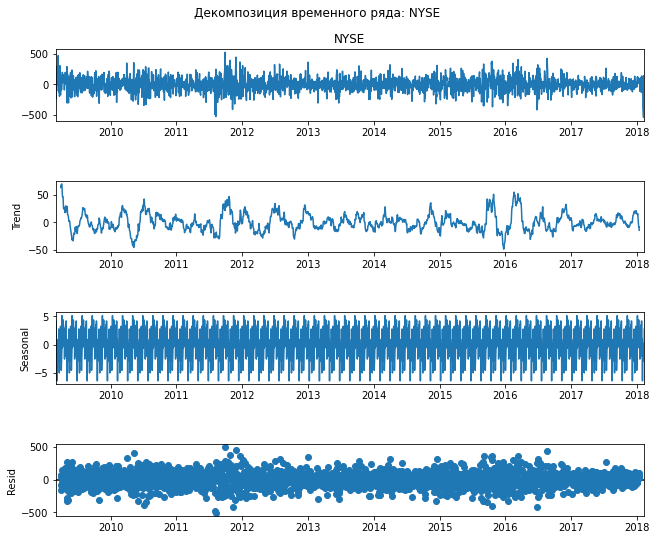

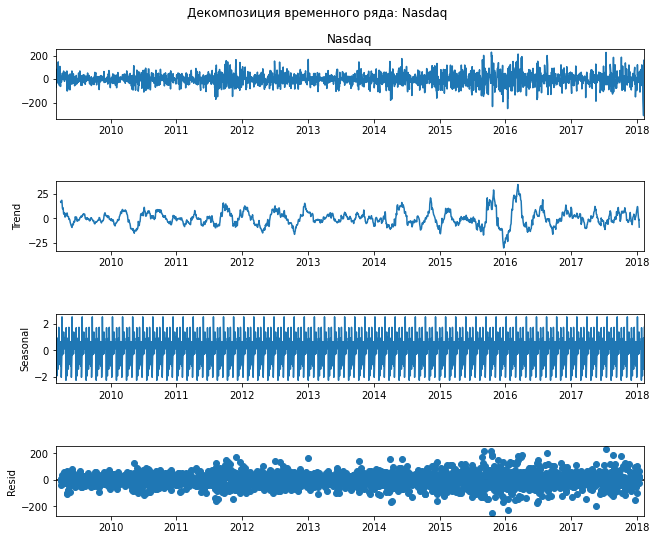

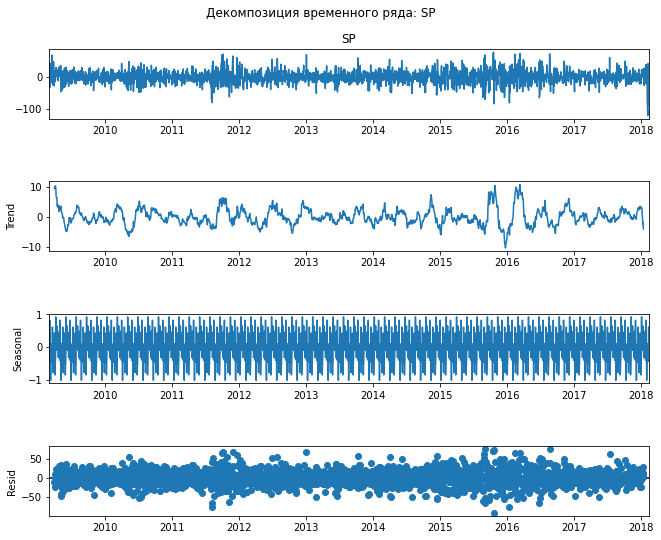

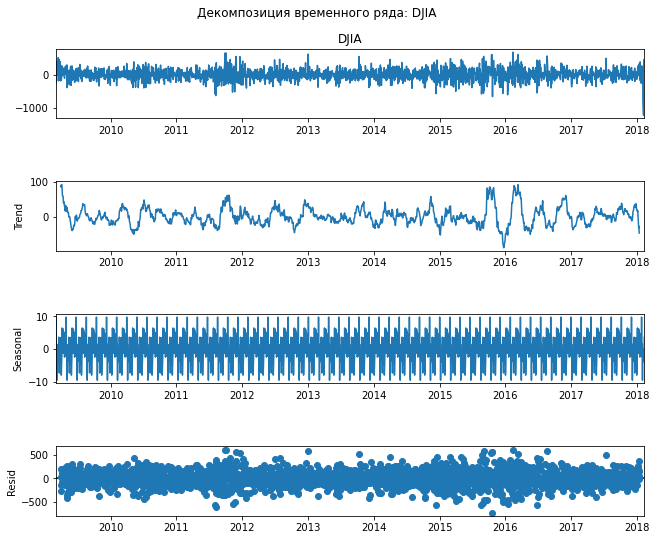

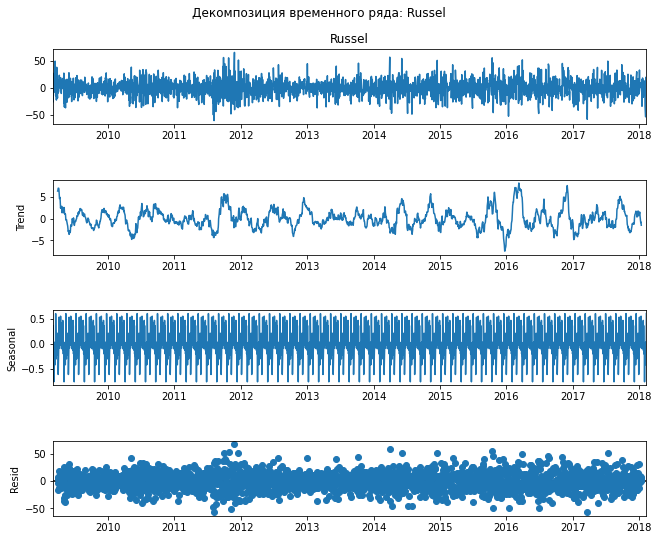

...

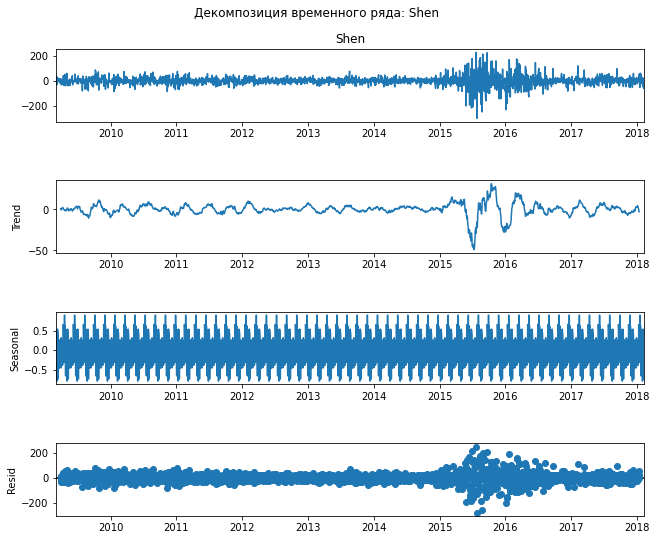

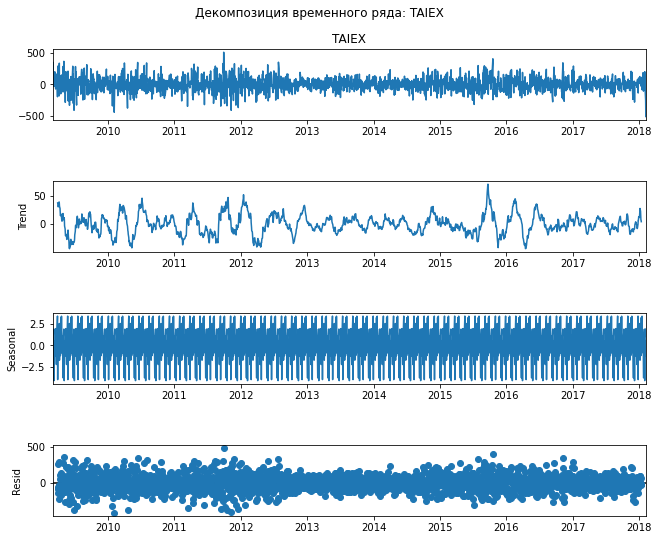

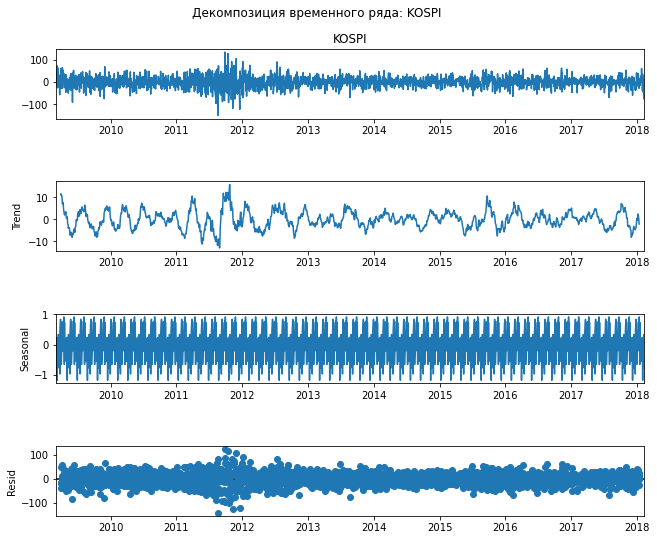

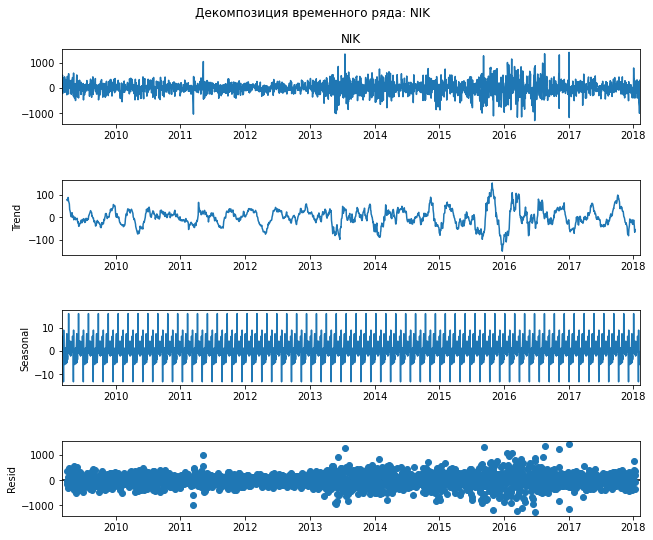

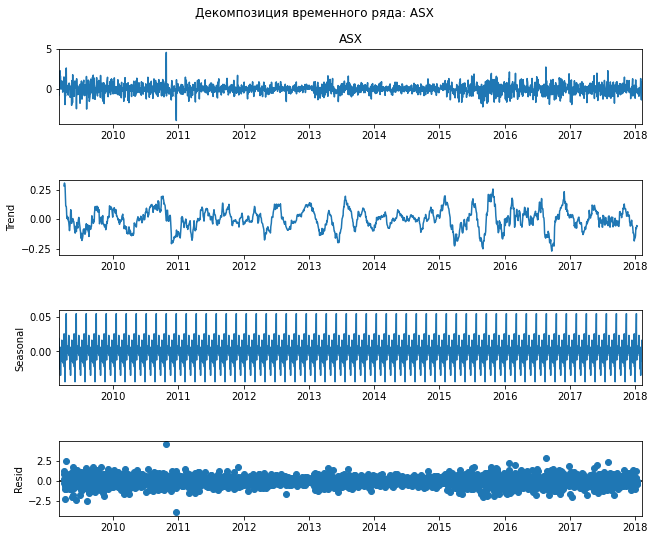

In [9]:
diff_data = df.diff().diff(40).dropna()  

for column in diff_data.columns:
    decomposition = sm.tsa.seasonal_decompose(diff_data[column], freq=40)
    fig = decomposition.plot()
    fig.set_size_inches(10, 8)
    plt.suptitle(f"Декомпозиция временного ряда: {column}")
    plt.show()

Заметим, что тренд ушёл, стал более хаотичным, в свою очередь сезонность осталась прежней. Воспользуемся другим методом.

# Экспоненциальное сглаживание

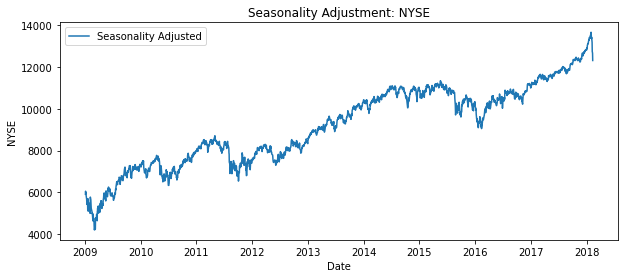

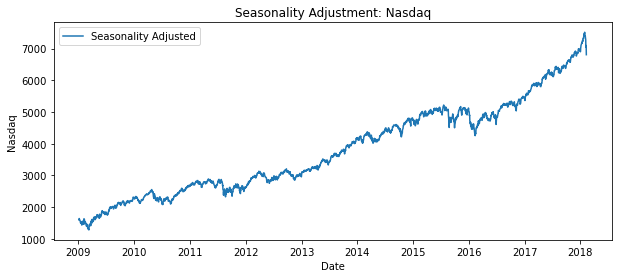

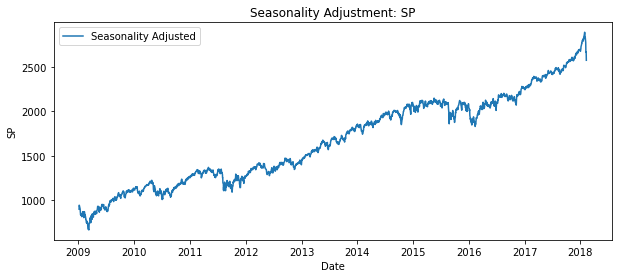

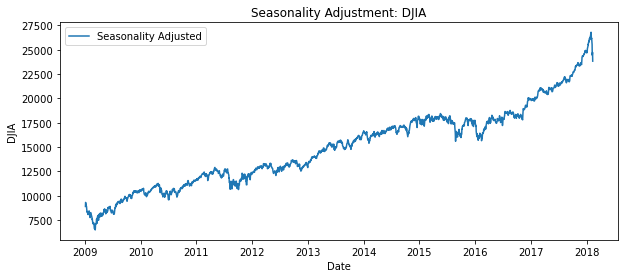

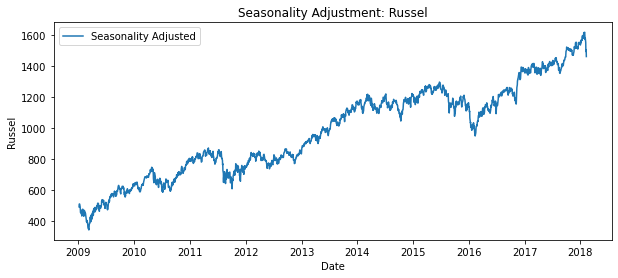

...

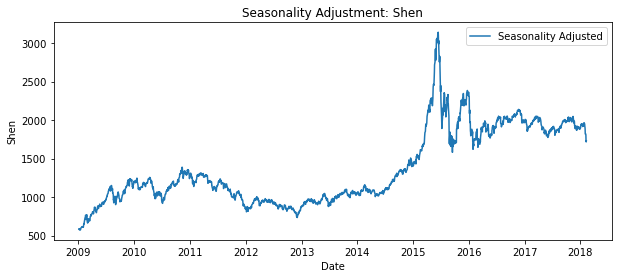

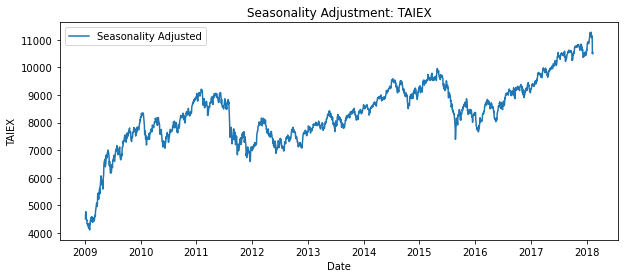

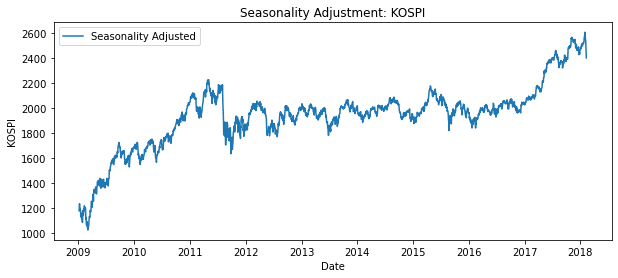

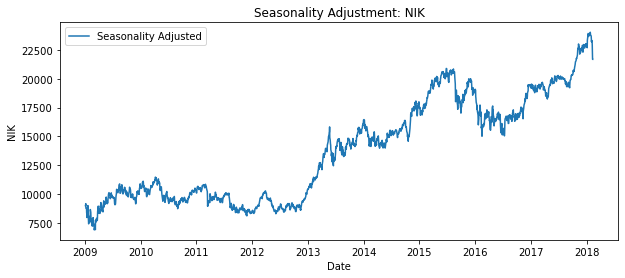

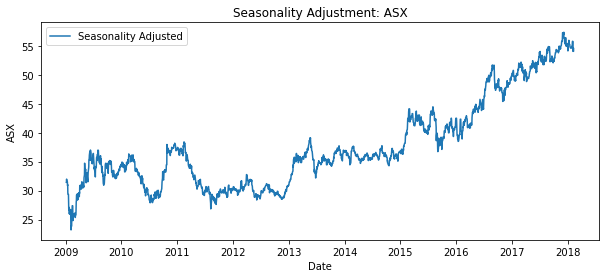

In [10]:
df_exp = df.copy()

for column in df_exp.columns:
    model = ExponentialSmoothing(df_exp[column], seasonal_periods=12, trend='add', seasonal='add')
    result = model.fit()

    df_exp[column] = result.fittedvalues

    plt.figure(figsize=(10, 4))
    plt.plot(df_exp.index, df_exp[column], label='Seasonality Adjusted')
    plt.xlabel('Date')
    plt.ylabel(column)
    plt.title('Seasonality Adjustment: ' + column)
    plt.legend()
    plt.show()

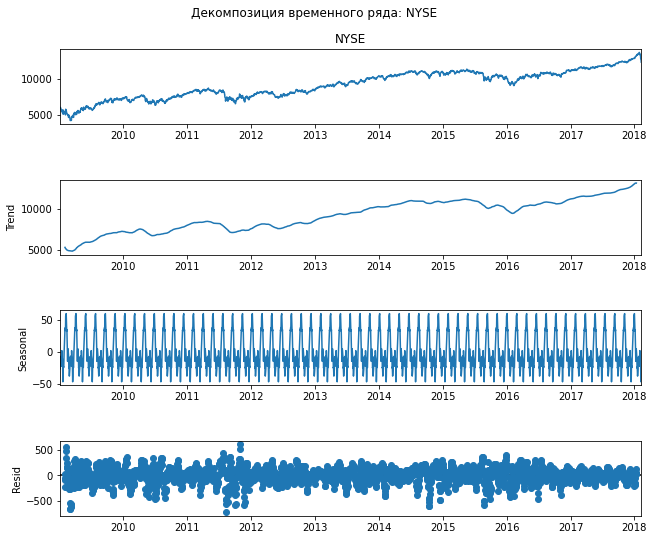

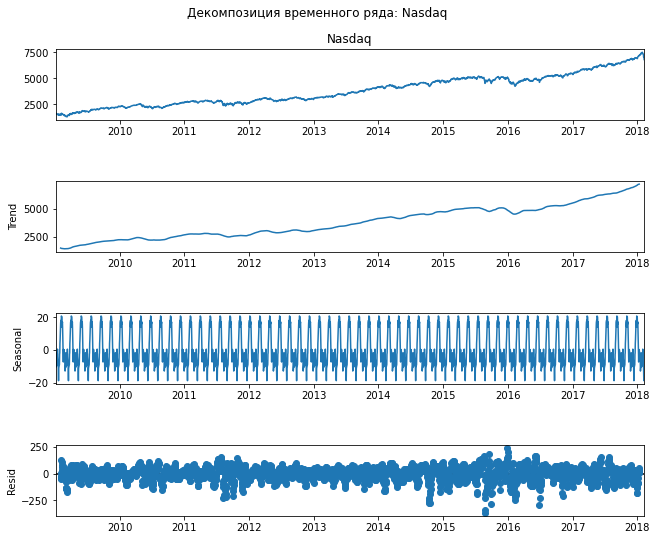

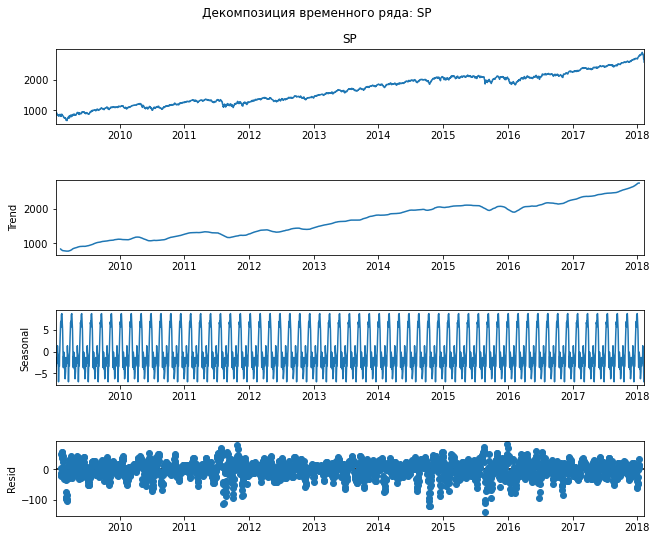

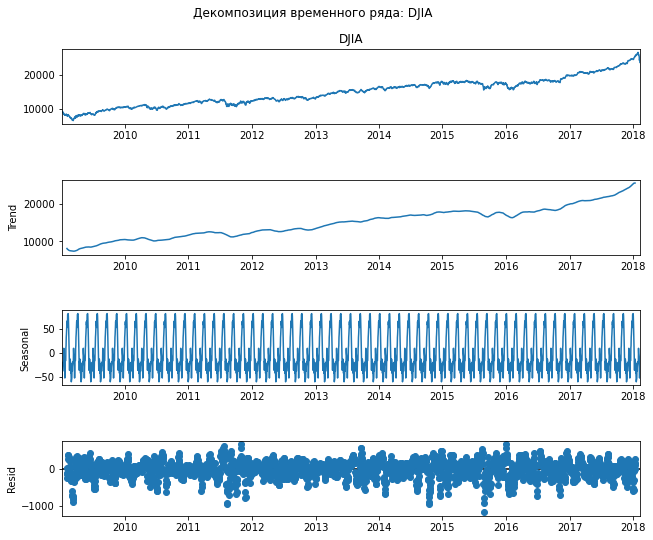

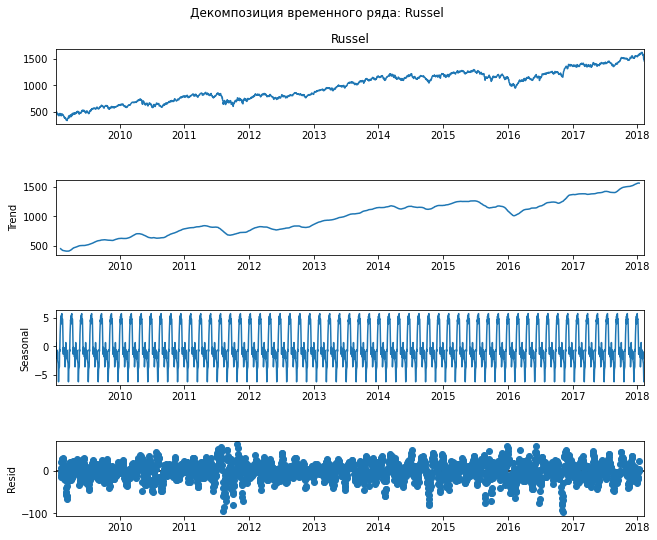

...

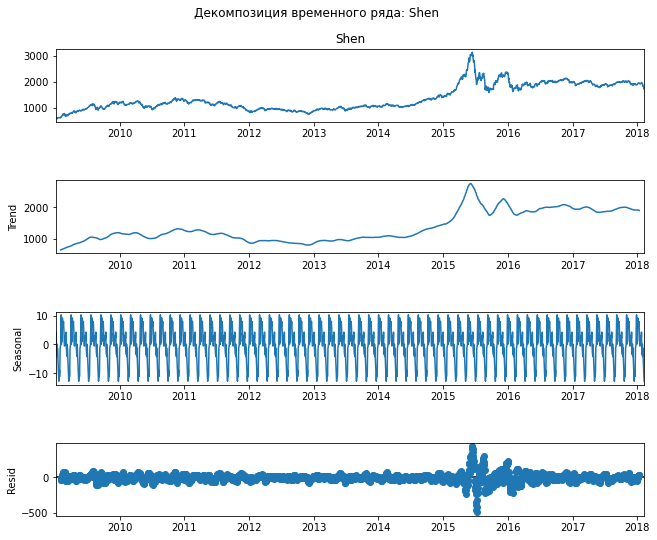

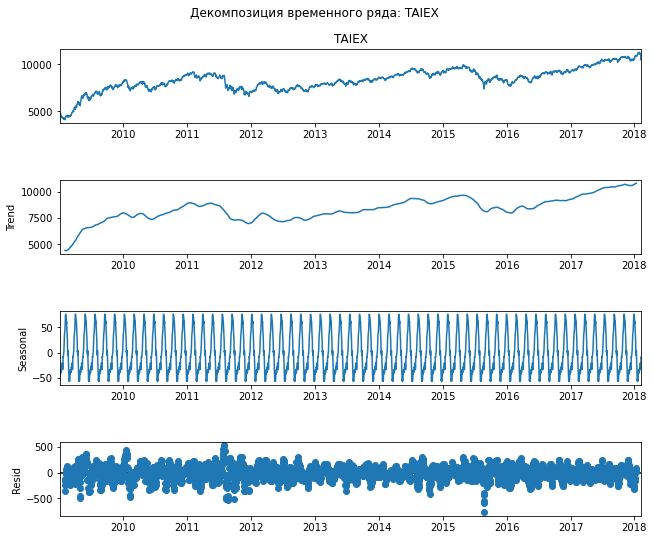

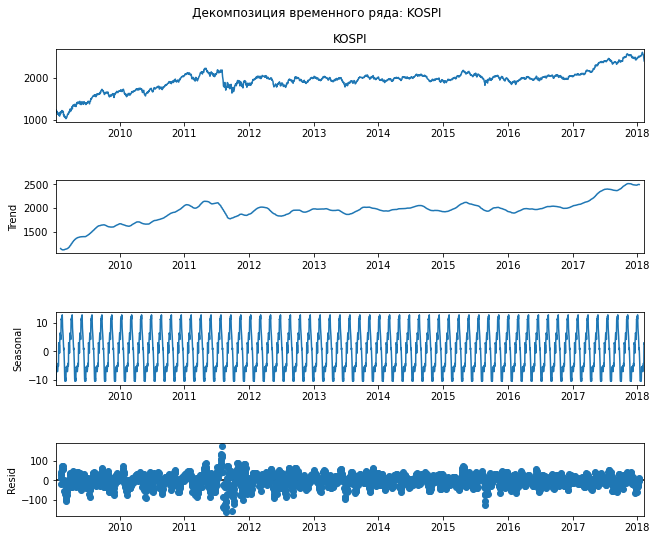

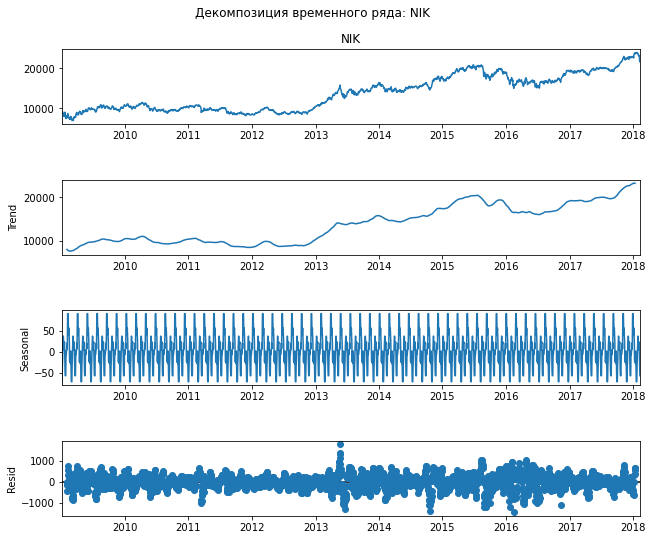

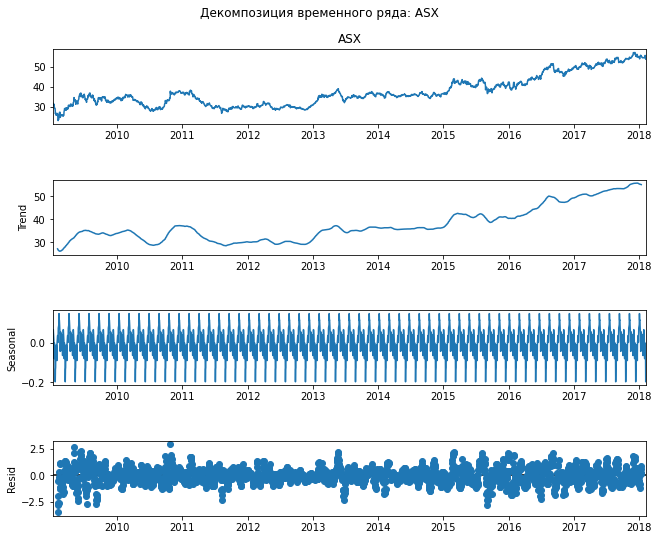

In [11]:
for column in df_exp.columns:
    decomposition = sm.tsa.seasonal_decompose(df_exp[column], freq=40)
    fig = decomposition.plot()
    fig.set_size_inches(10, 8)
    plt.suptitle(f"Декомпозиция временного ряда: {column}")
    plt.show()

Экспоненциальное сглаживание не сделало ряд стационарным.

# STL

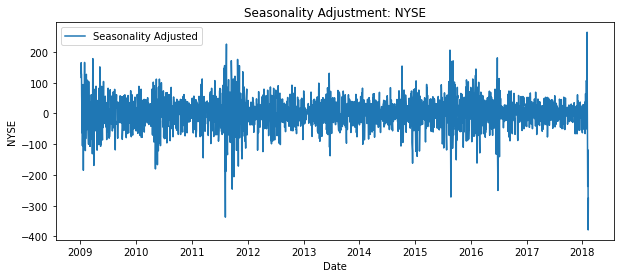

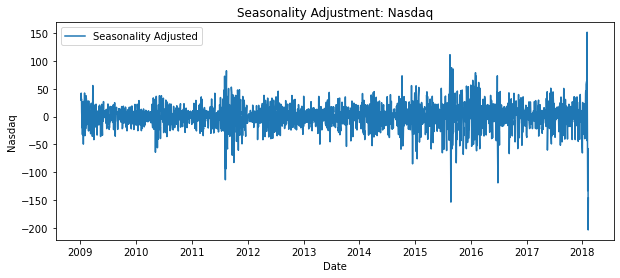

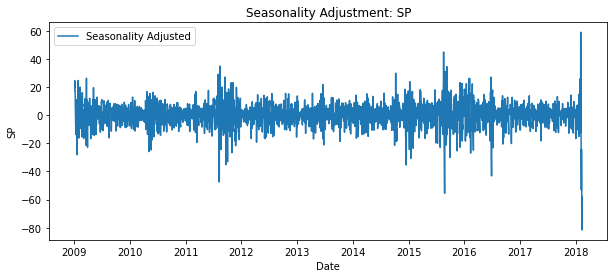

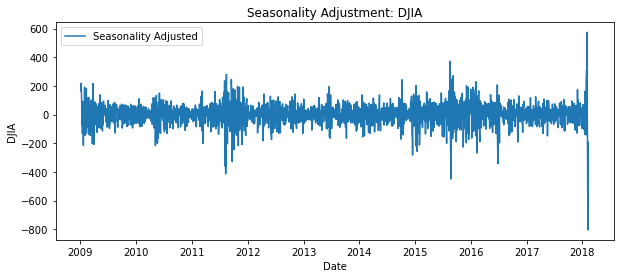

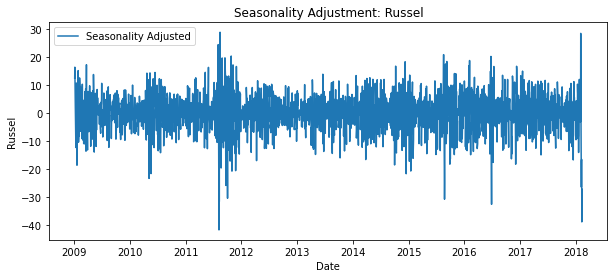

...

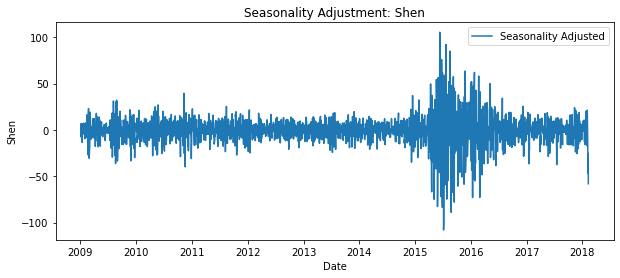

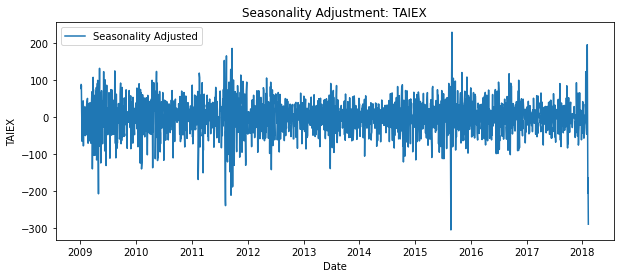

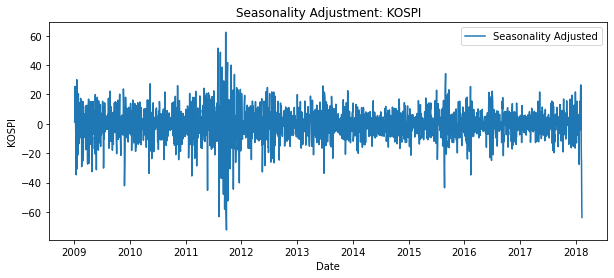

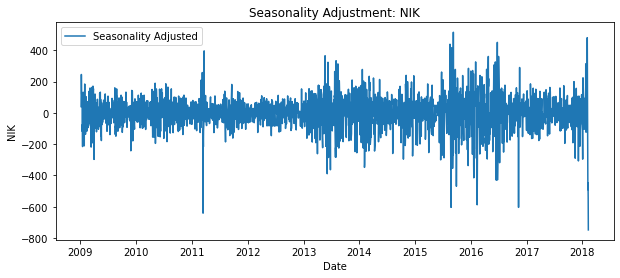

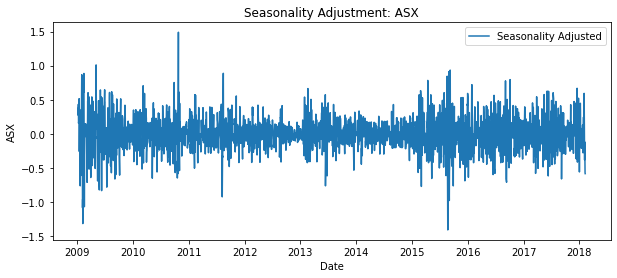

In [12]:
df_stl = df.copy()

for column in df_stl.columns:
    stl = STL(df_stl[column])
    result = stl.fit()

    df_stl[column] = result.resid

    plt.figure(figsize=(10, 4))
    plt.plot(df_stl.index, df_stl[column], label='Seasonality Adjusted')
    plt.xlabel('Date')
    plt.ylabel(column)
    plt.title('Seasonality Adjustment: ' + column)
    plt.legend()
    plt.show()


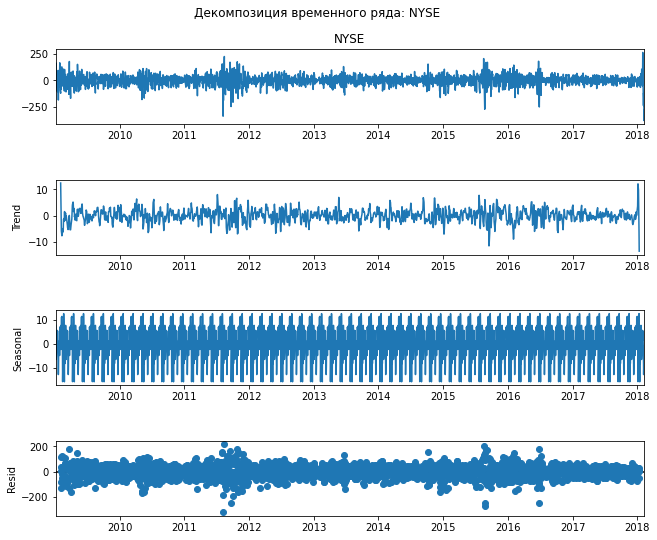

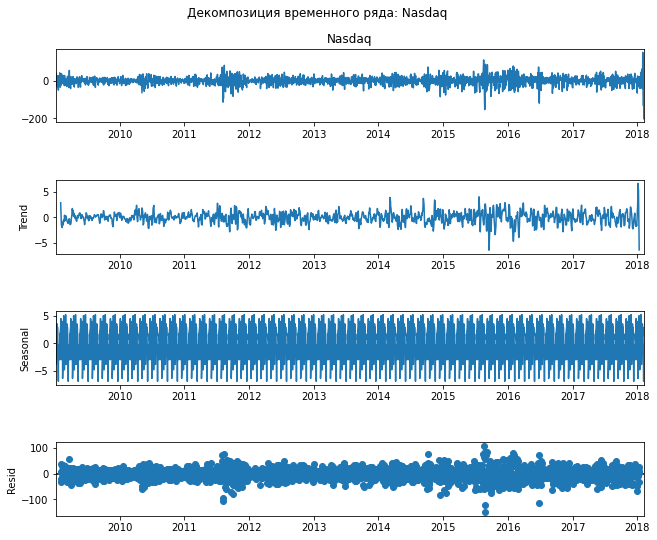

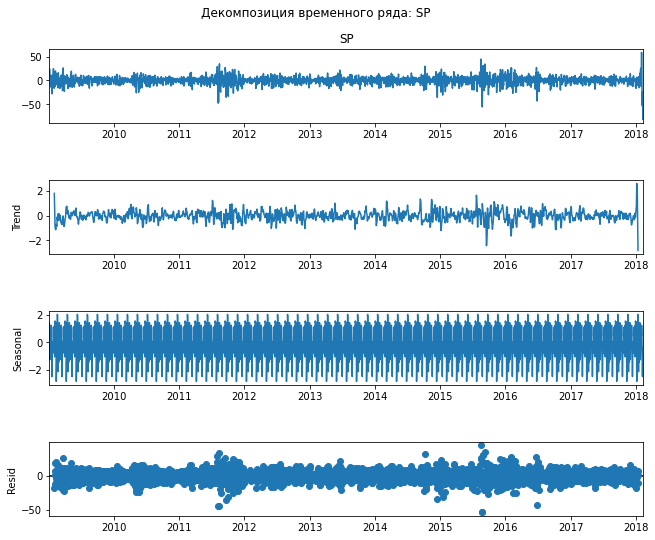

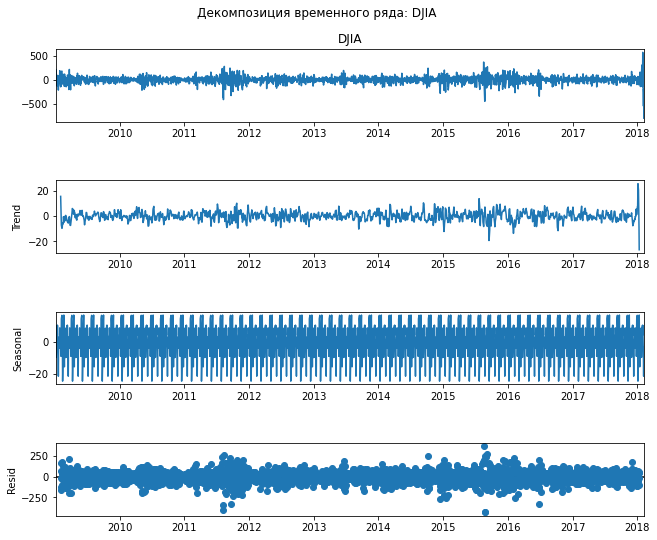

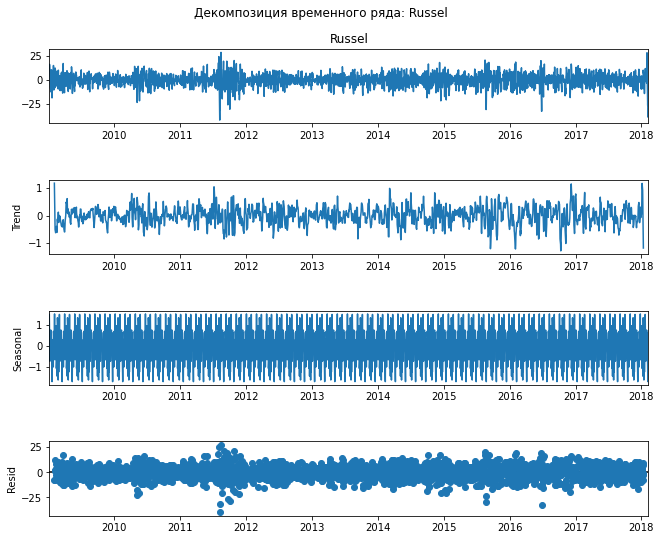

...

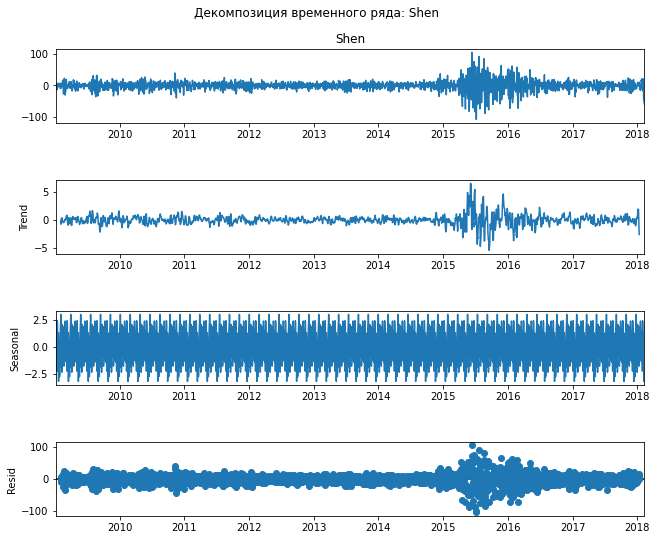

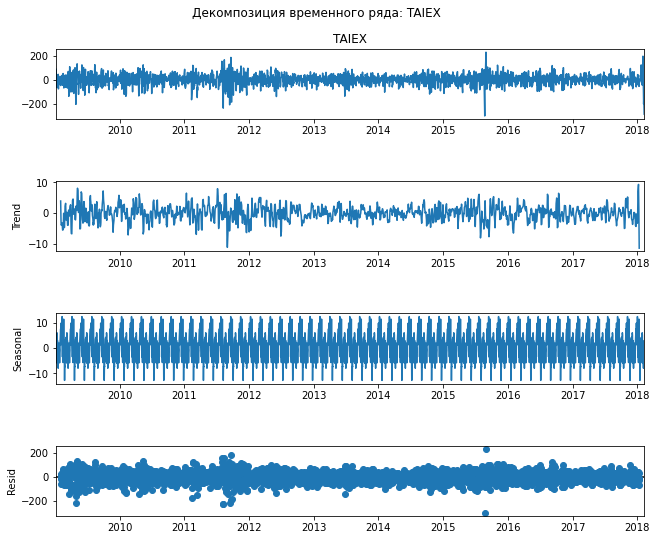

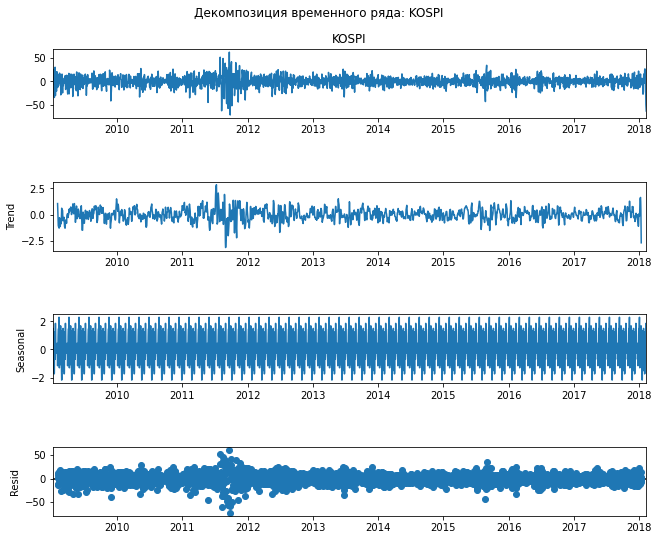

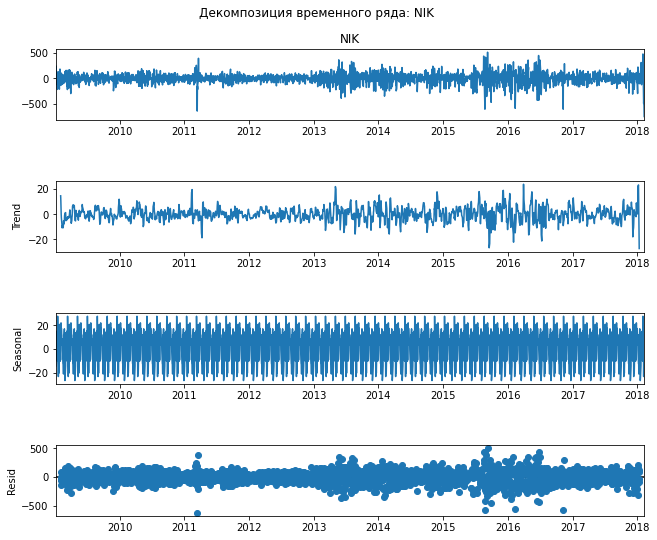

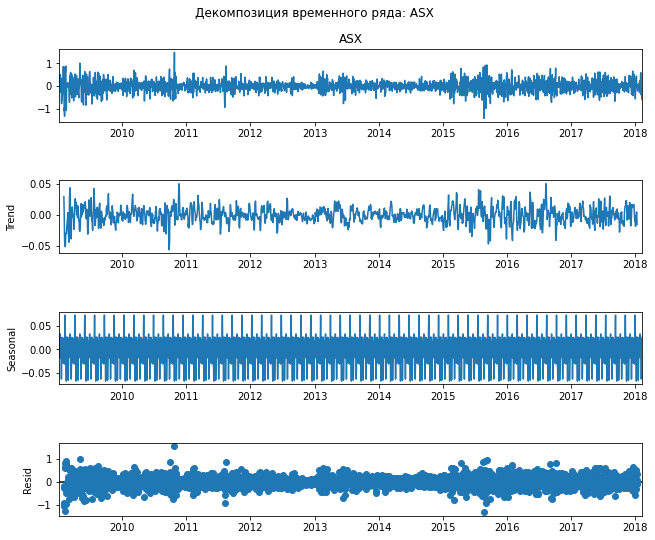

In [13]:
for column in df_stl.columns:
    decomposition = sm.tsa.seasonal_decompose(df_stl[column], freq=40)
    fig = decomposition.plot()
    fig.set_size_inches(10, 8)
    plt.suptitle(f"Декомпозиция временного ряда: {column}")
    plt.show()

STL также как двойное дифференцирование, сделало тренд более хаотичным, но сезонность отсалась прежней.

Мы использовали несколько способов для преобразования данных в стационарные. Ни один из них не убрал сезонность, соответсвенно, в таких случаях сезонные колебания представляют собой систематические и повторяющиеся паттерны, которые имеют существенное влияние на временной ряд и содержат информацию о поведении данных. Следовательно, нам необходимо построить модели, которые будут учитывать эти сезонности.

# SARIMA

SARIMA (Seasonal AutoRegressive Integrated Moving Average) - это модель временных рядов, которая учитывает сезонные компоненты данных.

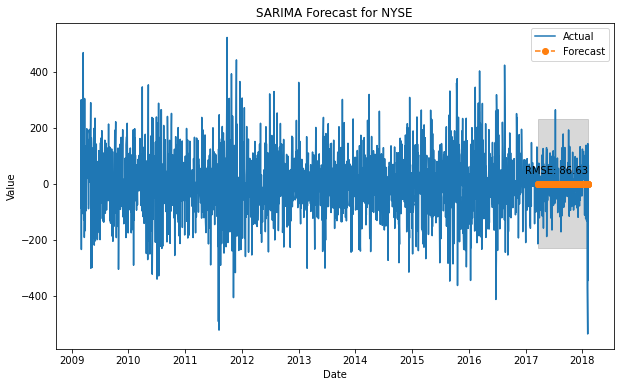

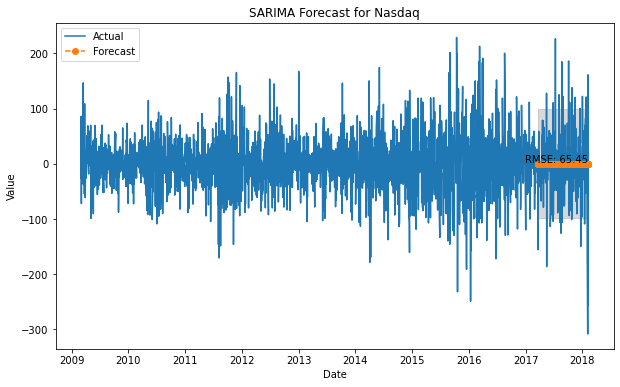

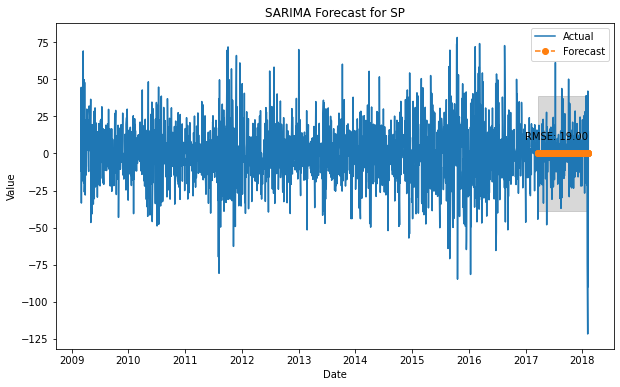

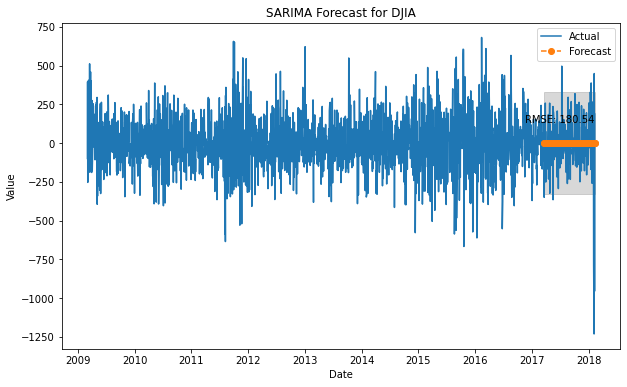

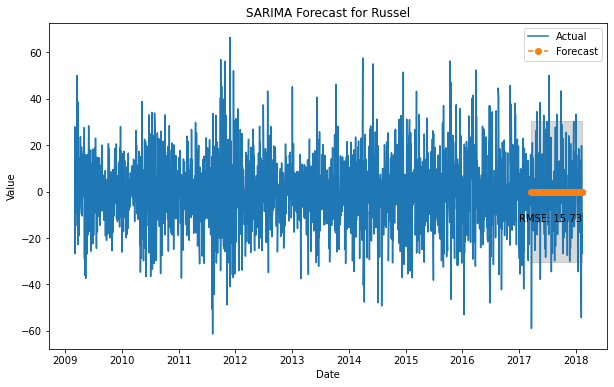

...

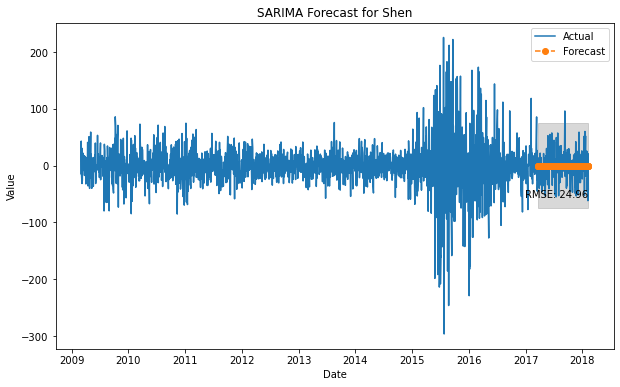

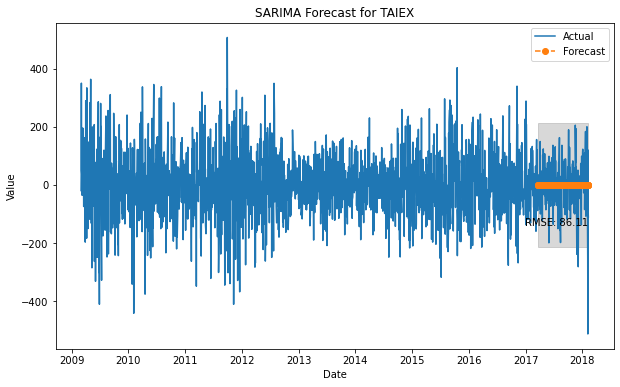

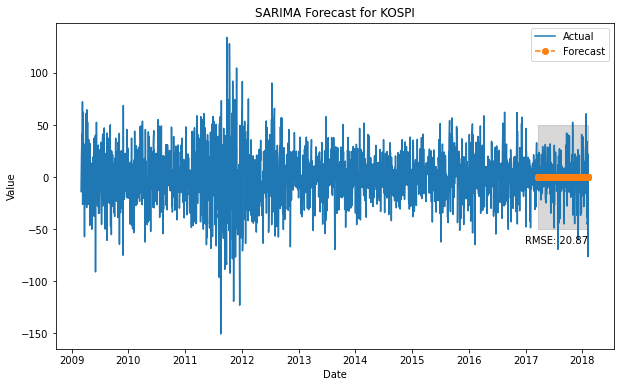

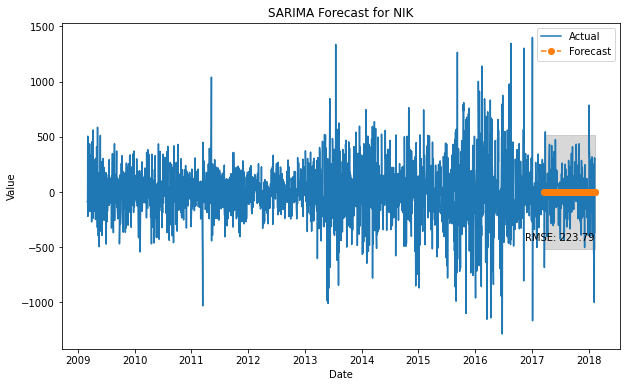

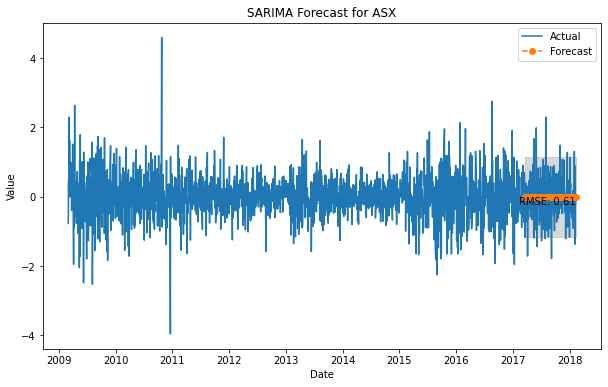

In [16]:
for column in diff_data.columns:
    
    series = diff_data[column]

    train_size = int(len(series) * 0.9)
    train_data, test_data = series[:train_size], series[train_size:]

    p = d = q = range(0, 1)
    pdq = list(itertools.product(p, d, q))

    seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

    best_aic = np.inf
    best_order = None
    best_seasonal_order = None

    for param in pdq:
        for param_seasonal in seasonal_pdq:
            try:
                model = sm.tsa.statespace.SARIMAX(train_data, order=param, seasonal_order=param_seasonal)
                results = model.fit()

                if results.aic < best_aic:
                    best_aic = results.aic
                    best_order = param
                    best_seasonal_order = param_seasonal

            except:
                continue

    best_model = sm.tsa.statespace.SARIMAX(train_data, order=best_order, seasonal_order=best_seasonal_order)
    best_results = best_model.fit()

    forecast = best_results.get_forecast(steps=len(test_data))
    forecasted_values = forecast.predicted_mean

    plt.figure(figsize=(10, 6))
    plt.plot(series.index, series, label='Actual')
    plt.plot(test_data.index, forecasted_values, linestyle='--', marker='o', label='Forecast')
    plt.fill_between(test_data.index, forecast.conf_int().iloc[:, 0], forecast.conf_int().iloc[:, 1], color='gray', alpha=0.3)
    plt.title(f'SARIMA Forecast for {column}')
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.legend()

    rmse = sqrt(mean_squared_error(test_data, forecasted_values))
    plt.text(series.index[-1], series.iloc[-1], f'RMSE: {rmse:.2f}', ha='right', va='top')

    plt.show()

В цикле for column in diff_data.columns: происходит перебор всех столбцов в diff_data.
series = diff_data[column] -  Создается переменная series, которая содержит значения временного ряда для текущего столбца.
Далее определяется размер обучающей выборки и тестовой выборки с помощью.
Создаются комбинации параметров pdq и seasonal_pdq для модели SARIMA с помощью функции list(itertools.product()). pdq содержит параметры для несезонной составляющей модели, а seasonal_pdq - для сезонной составляющей.
Инициализируются переменные best_aic, best_order и best_seasonal_order для выбора лучшей модели SARIMA на основе значения информационного критерия Акаике (AIC).
Во вложенных циклах for param in pdq: и for param_seasonal in seasonal_pdq: создаются и обучаются модели SARIMA с различными комбинациями параметров. Лучшая модель определяется по значению AIC.
После выбора лучшей модели, она повторно обучается на всем обучающем наборе данных (best_model = sm.tsa.statespace.SARIMAX(train_data, order=best_order, seasonal_order=best_seasonal_order)).
Выполняется прогноз на длину тестовой выборки (forecast = best_results.get_forecast(steps=len(test_data))).
Строится график, на котором отображаются фактические значения временного ряда (series) и прогнозируемые значения (forecasted_values). Также отображается доверительный интервал для прогноза.
Рассчитывается корень из среднеквадратической ошибки (RMSE) между фактическими значениями и прогнозируемыми значениями.
\
Таким образом, код выполняет моделирование SARIMA для каждого столбца в diff_data и выводит на график фактические значения и прогнозируемые значения, а также RMSE в конце графика.

In [27]:
diff_data

,NYSE,Nasdaq,SP,DJIA,Russel,TSX,IBOVES,MERVAL,WTI,FTSE,...,TEPIX,BSE,CNX,HSI,SSE,Shen,TAIEX,KOSPI,NIK,ASX
Date,,,,,,,,,,,,,,,,,,,,,
2009-03-03,-86.689453,-26.189942,-11.739990,-99.48,-16.470001,-242.499511,-560.0,-76.109985,1.55,-173.02,...,-15.2,-240.120118,-43.550294,-229.780274,-78.445191,-14.197021,-19.439941,-13.950135,-88.149414,-0.768001
2009-03-04,299.979981,86.049926,44.589966,395.22,27.899994,533.999511,3426.0,103.369995,9.52,265.19,...,-15.6,768.250000,215.200196,819.320313,139.809083,43.257934,43.500000,-0.199951,-97.160644,0.364302
2009-03-05,-235.380371,-72.099975,-33.399963,-254.16,-26.759980,-285.899414,-2204.0,-56.839904,-0.67,-113.87,...,0.0,-248.570312,-68.500000,451.639648,68.799927,15.134033,349.830078,21.390137,505.350585,0.482399
2009-03-06,151.660156,39.680054,20.210021,175.78,22.309998,98.699219,144.0,23.099914,2.88,57.70,...,0.0,308.310547,90.849853,-251.250977,-54.748780,-16.759949,49.479493,21.589965,-220.770019,0.000000
2009-03-09,93.160157,7.589966,13.239990,45.32,4.710022,267.300292,1816.0,39.000000,4.62,34.02,...,-11.9,130.999511,52.899902,-170.499023,-69.745117,-31.408080,23.450683,40.909912,-87.070313,2.293901
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-02-05,-537.580078,-308.420410,-121.679932,-1232.08,-54.300049,-278.600586,-2248.0,-1934.730469,-2.01,-167.97,...,-560.2,-515.078126,-150.649413,-681.998048,-6.788087,-43.410000,-254.450196,-41.129883,-720.099610,-1.370003
2018-02-06,142.959961,161.110352,42.079835,448.25,19.800049,18.600586,1019.0,444.060548,0.02,-240.51,...,-1182.5,-333.417968,-86.200196,-1478.392577,-75.462890,-61.610000,-512.440429,-27.949951,-999.279297,0.889999
2018-02-07,-59.970703,-77.379884,-12.219972,-100.05,-7.530029,-55.900391,-227.0,309.560546,-1.04,141.92,...,-282.6,61.718750,25.650391,-700.439453,-83.615234,-26.380000,120.120117,-76.300049,143.228516,-0.039996


Мы видим, что на всех графиках предсказанные значения выглядит как прямая линия, возможно это связано с тем, что модель имеет ограниченную способность улавливать сложные паттерны. Попробуем воспользовать более сложными моделями, такими как CNN и RNN.

# CNN

Training Progress: 100%|█████████████████████████████████████████████████████████████| 100/100 [00:09<00:00, 10.31it/s]


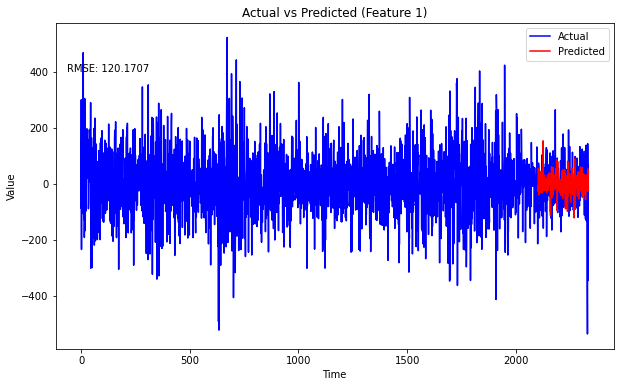

RMSE: 120.1707


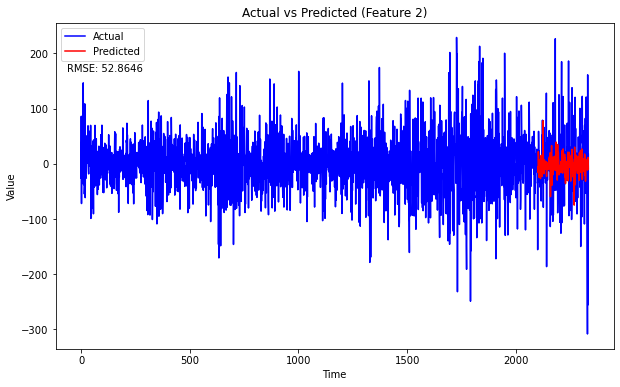

RMSE: 52.8646


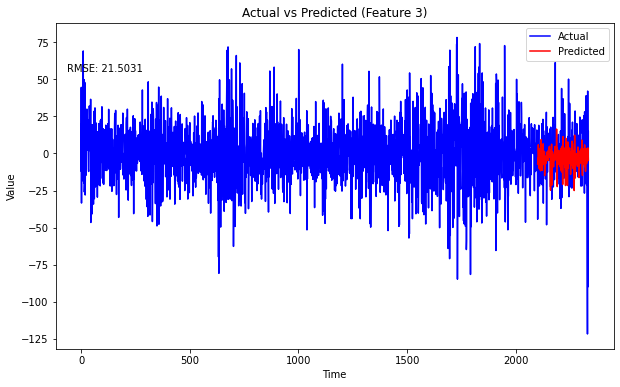

RMSE: 21.5031


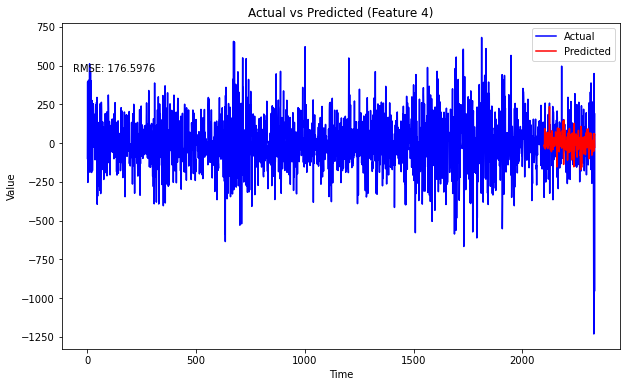

RMSE: 176.5976


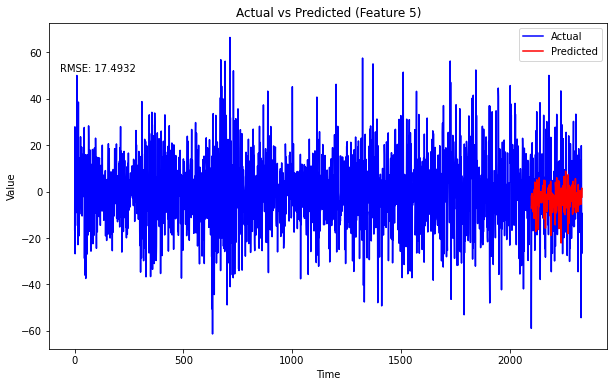

RMSE: 17.4932


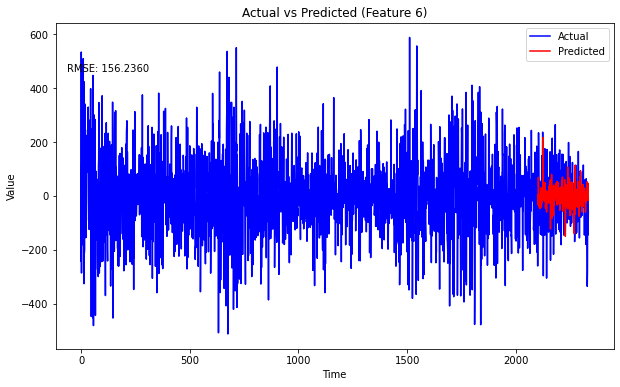

RMSE: 156.2360


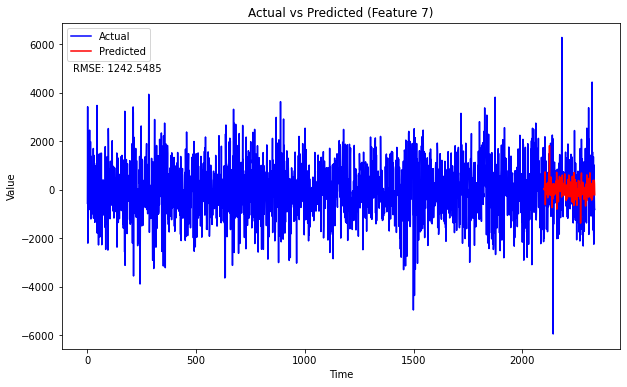

RMSE: 1242.5485


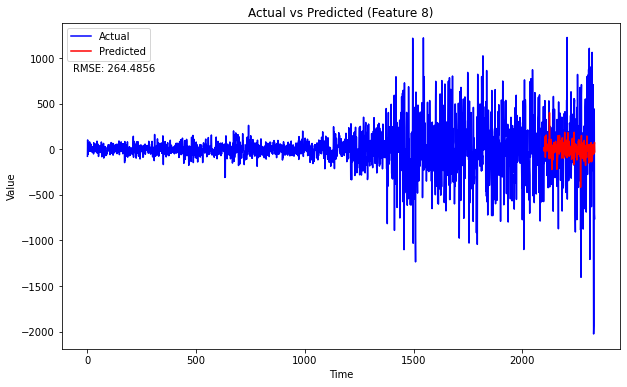

RMSE: 264.4856


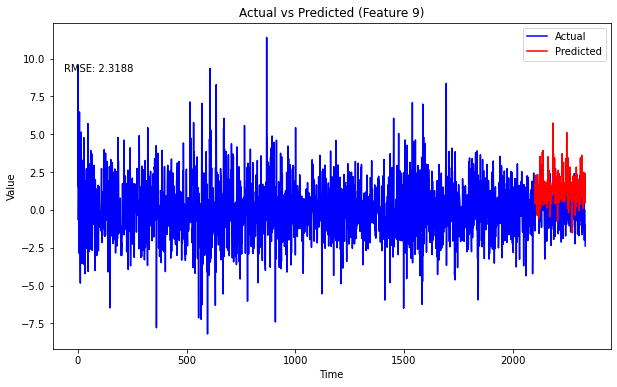

RMSE: 2.3188


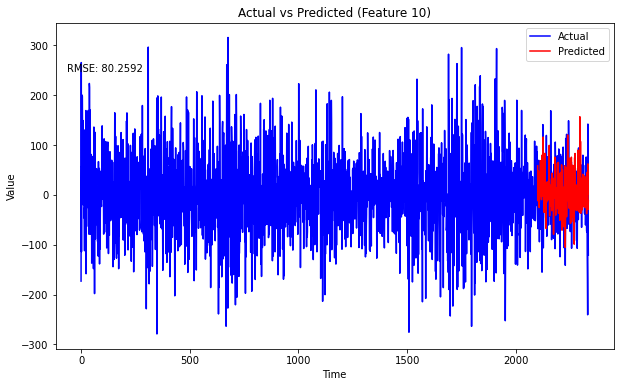

RMSE: 80.2592


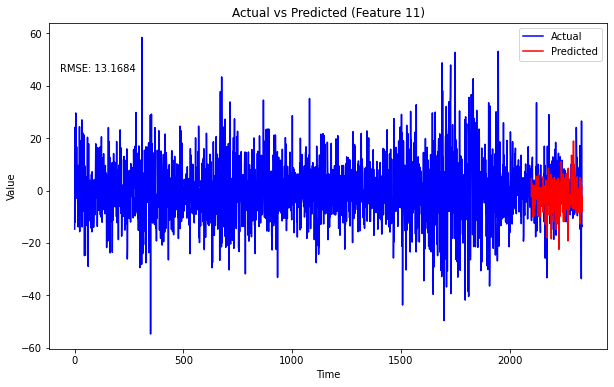

RMSE: 13.1684


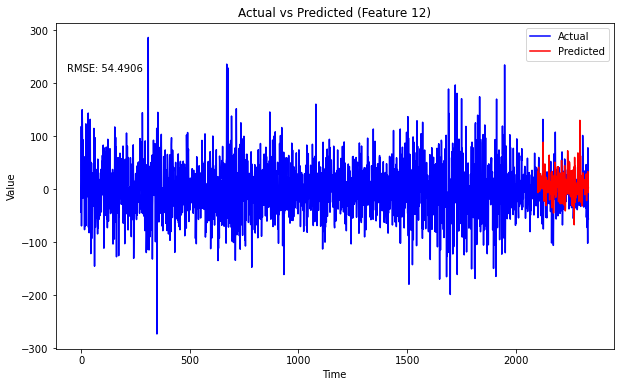

RMSE: 54.4906


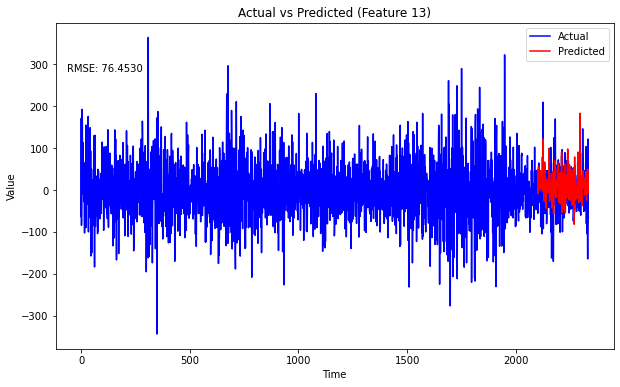

RMSE: 76.4530


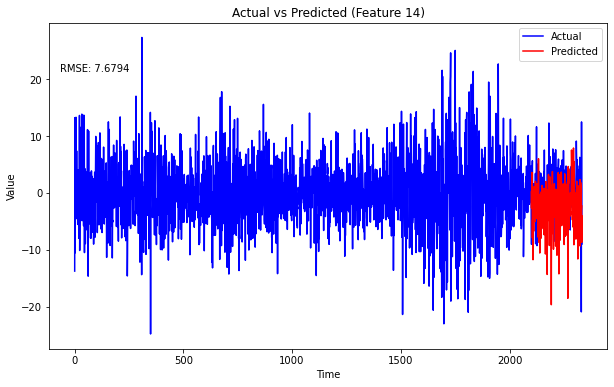

RMSE: 7.6794


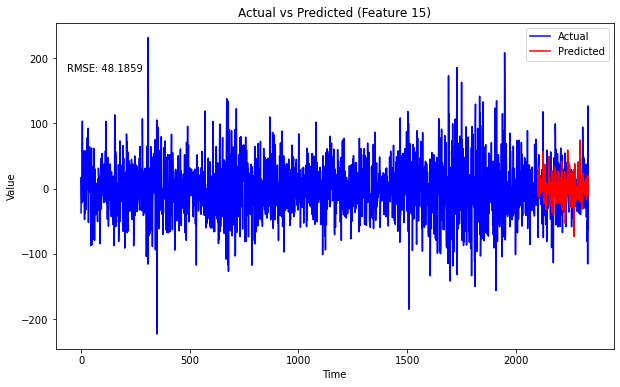

RMSE: 48.1859


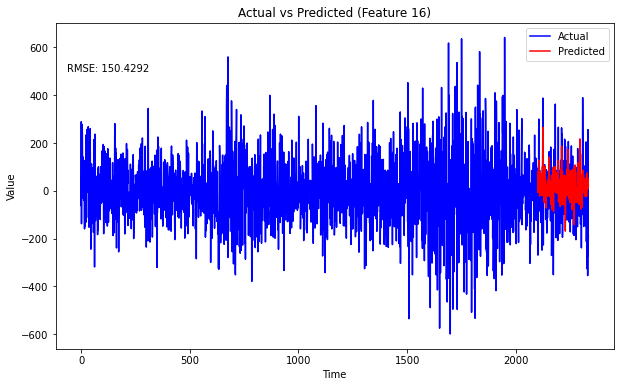

RMSE: 150.4292


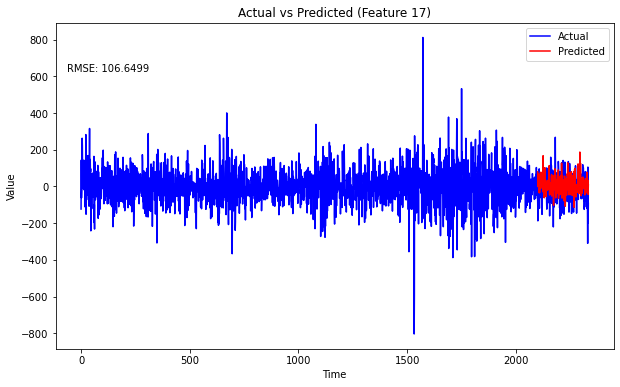

RMSE: 106.6499


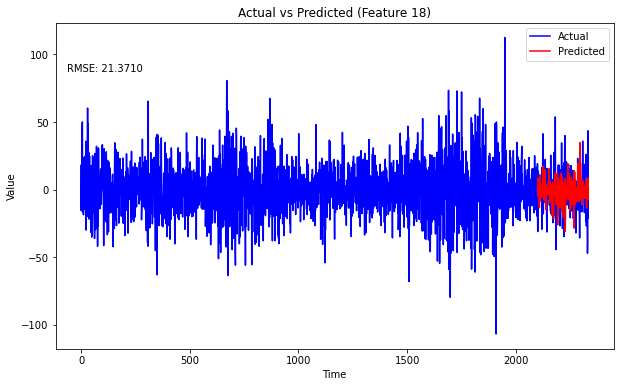

RMSE: 21.3710


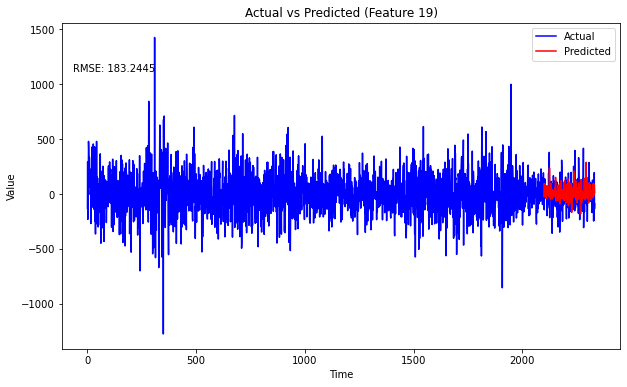

RMSE: 183.2445


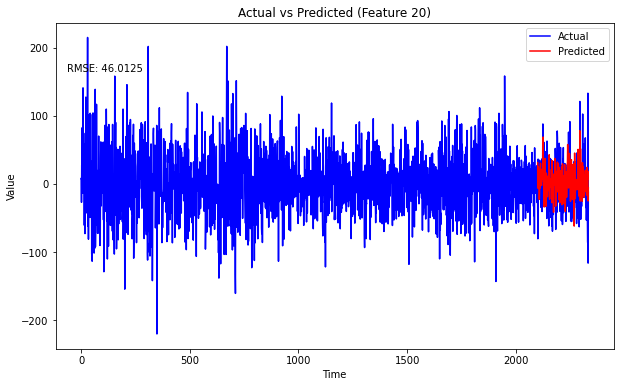

RMSE: 46.0125


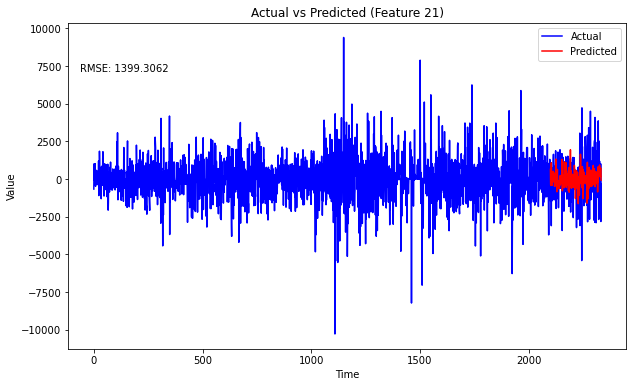

RMSE: 1399.3062


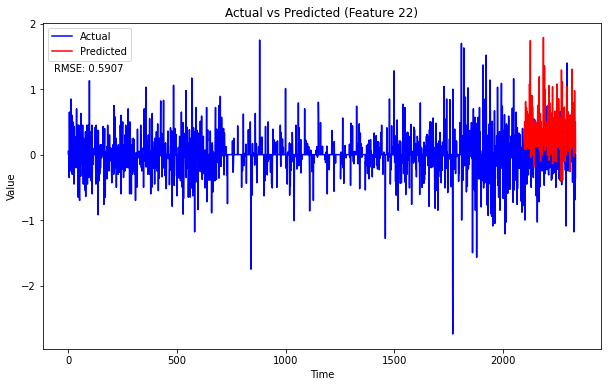

RMSE: 0.5907


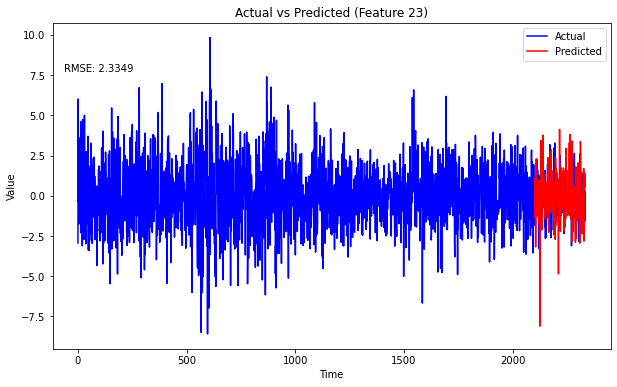

RMSE: 2.3349


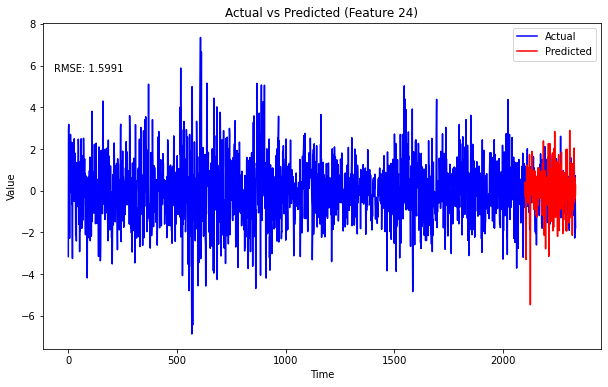

RMSE: 1.5991


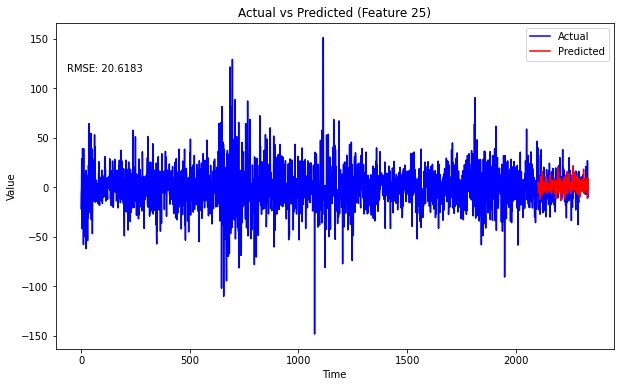

RMSE: 20.6183


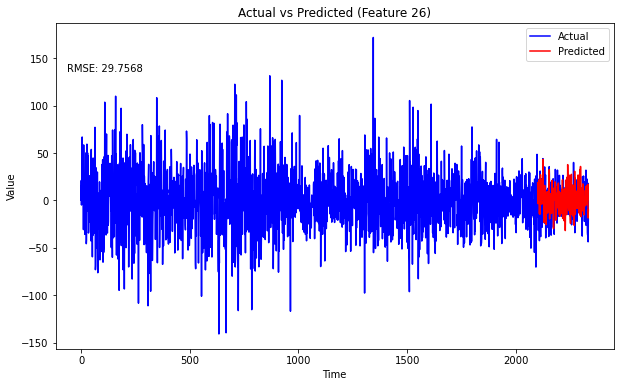

RMSE: 29.7568


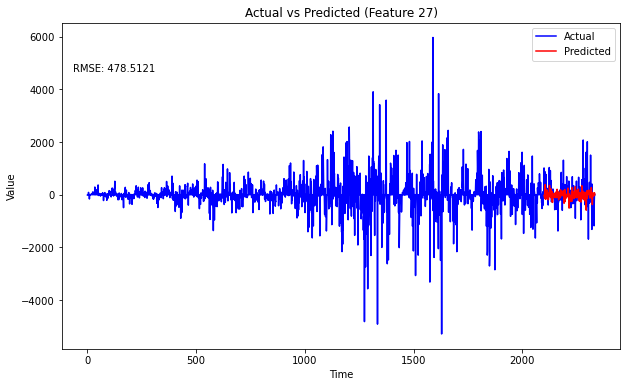

RMSE: 478.5121


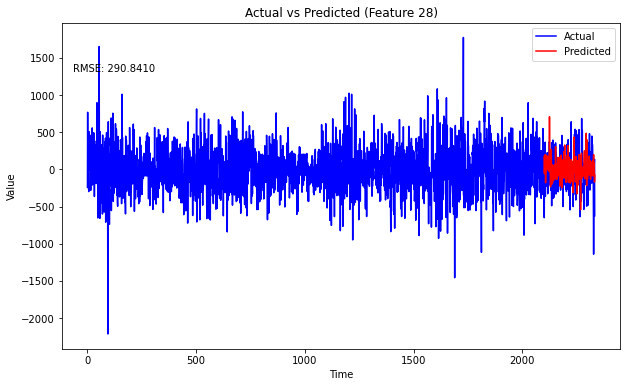

RMSE: 290.8410


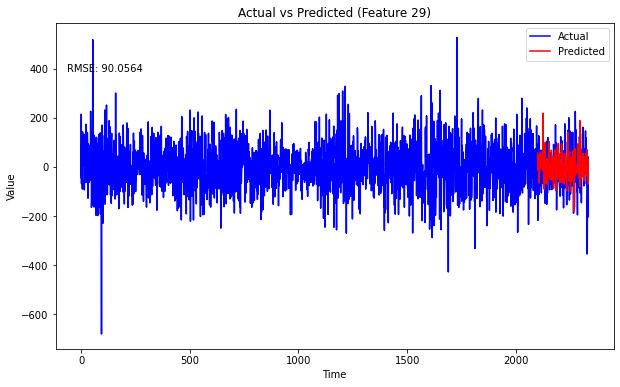

RMSE: 90.0564


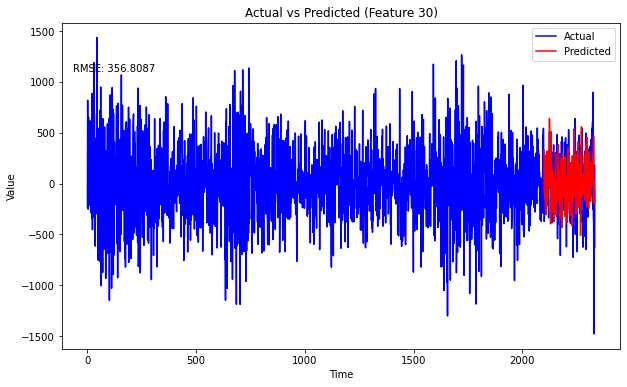

RMSE: 356.8087


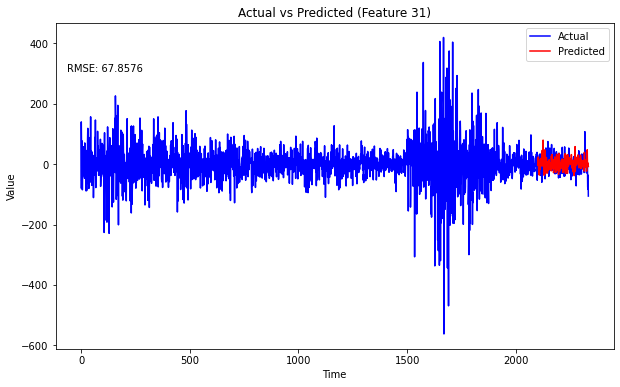

RMSE: 67.8576


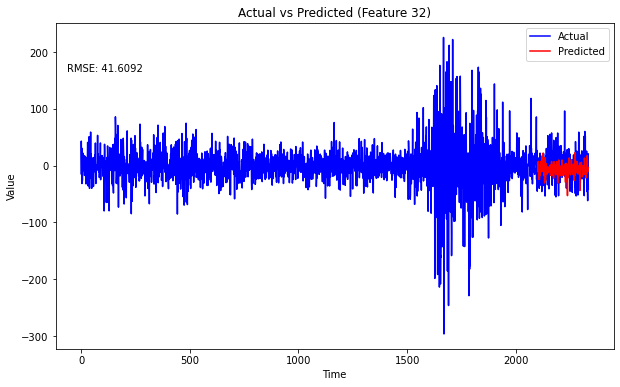

RMSE: 41.6092


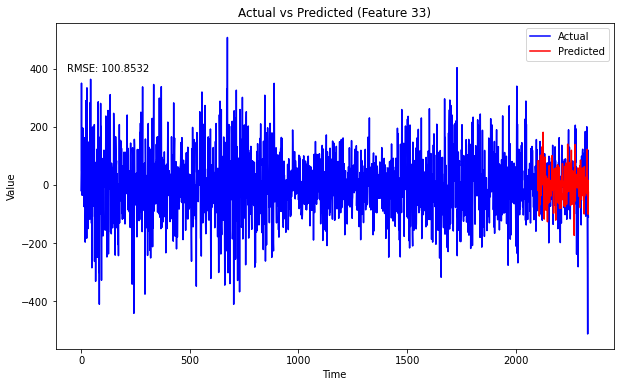

RMSE: 100.8532


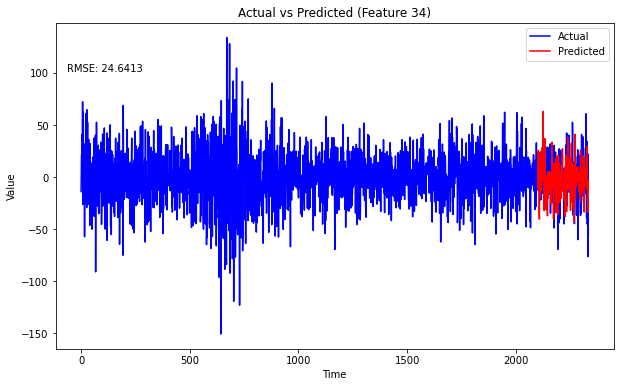

RMSE: 24.6413


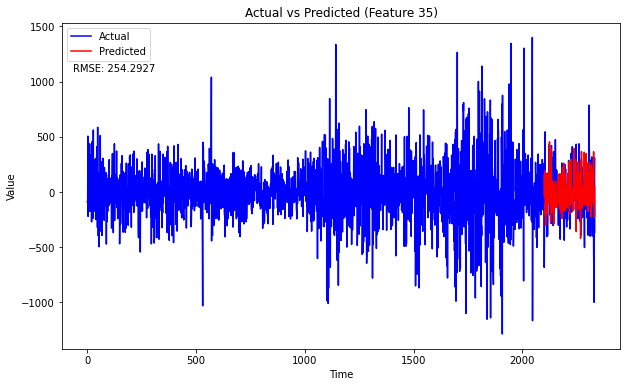

RMSE: 254.2927


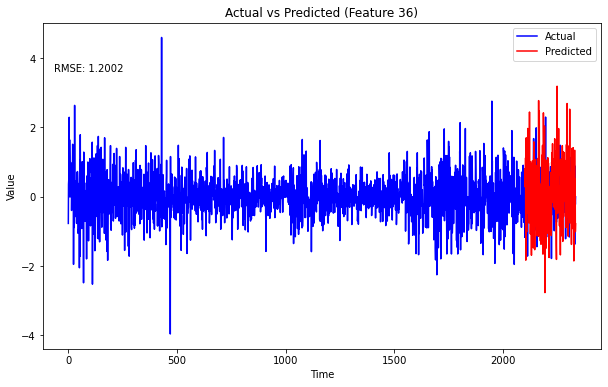

RMSE: 1.2002


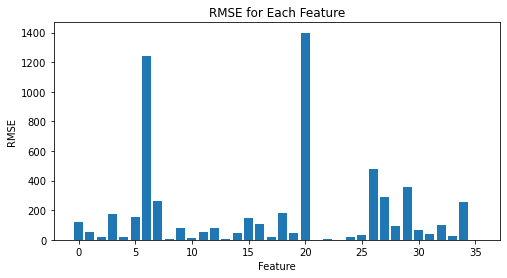

In [105]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from tqdm import tqdm
import torch.nn.functional as F


def split_sequences(sequences):
    X, y = [], []
    for i in range(len(sequences)):
        end_ix = i + 1
        if end_ix > len(sequences) - 1:
            break
        seq_x, seq_y = sequences[i:end_ix], sequences[end_ix]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

dataset = diff_data.to_numpy()

n_features = dataset.shape[1]

X_train_list = []
X_test_list = []
y_train_list = []
y_test_list = []

for i in range(n_features):
    X_i, y_i = split_sequences(dataset[:, i])
    X_train_i, X_test_i, y_train_i, y_test_i = train_test_split(X_i, y_i, test_size=0.1, random_state=42)
    X_train_list.append(X_train_i)
    X_test_list.append(X_test_i)
    y_train_list.append(y_train_i)
    y_test_list.append(y_test_i)

X_train_tensor = torch.Tensor(np.stack(X_train_list, axis=1))
y_train_tensor = torch.Tensor(np.stack(y_train_list, axis=1))
X_test_tensor = torch.Tensor(np.stack(X_test_list, axis=1))
y_test_tensor = torch.Tensor(np.stack(y_test_list, axis=1))

class ConvNet(nn.Module):
    def __init__(self, n_channels, n_features):
        super(ConvNet, self).__init__()
        self.conv1 = nn.Conv1d(n_channels, 64, kernel_size=1)
        self.pool = nn.MaxPool1d(kernel_size=2, stride=1, padding=1)  
        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(128, 50)
        self.fc2 = nn.Linear(50, n_features)

    def forward(self, x):
        x = self.conv1(x)
        x = self.pool(x)
        x = self.flatten(x)
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x

n_channels = X_train_tensor.shape[1]

model = ConvNet(n_channels, n_features)

loss_fn = nn.MSELoss()

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

epochs = 100
progress_bar = tqdm(total=epochs, desc='Training Progress')
for epoch in range(epochs):
    model.train()
    for batch_X, batch_y in train_loader:
        pred_y = model(batch_X)

        loss = loss_fn(pred_y, batch_y)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    progress_bar.update(1)
progress_bar.close()

model.eval()
y_pred = model(X_test_tensor)

y_test_pred = y_pred.detach().numpy()
y_test_np = y_test_tensor.numpy()

rmse_values = []
for i in range(n_features):
    y_pred_i = y_test_pred[:, i]
    y_test_i = y_test_np[:, i]
    rmse = np.sqrt(mean_squared_error(y_test_i, y_pred_i))
    rmse_values.append(rmse)

    x = np.arange(len(dataset))
    plt.figure(figsize=(10, 6))
    plt.plot(x, dataset[:, i], label='Actual', color='blue')
    plt.plot(x[-len(y_pred):], y_pred.detach().numpy()[:, i], label='Predicted', color='red')
    plt.xlabel('Time')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted (Feature {i+1})')
    plt.legend()
    plt.text(0.02, 0.85, f'RMSE: {rmse:.4f}', transform=plt.gca().transAxes)
    plt.show()   
    print(f'RMSE: {rmse:.4f}')

plt.figure(figsize=(8, 4))
plt.bar(range(n_features), rmse_values)
plt.xlabel('Feature')
plt.ylabel('RMSE')
plt.title('RMSE for Each Feature')
plt.show()


Модель показала себя достаточно хорошо, заметно что предсказанные значения, пытаются повторить изначальные. Также метрика RMSE не велика.

Строим обучение и прогнозирование с использованием сверточной нейронной сети (ConvNet) для временных рядов.
Функция split_sequences разделяет последовательности (sequences) на входные и выходные данные для модели. Входные данные X представляют собой n_steps предыдущих значений временного ряда, а выходные данные y представляют следующее значение после входных данных.
X, y = split_sequences(dataset, n_steps) разделяет данные на обучающую выборку X и выходные значения y с использованием функции split_sequences.
n_features = X.shape[2] определяет количество признаков в данных.
Создается класс ConvNet, который определяет архитектуру сверточной нейронной сети с одним сверточным слоем, пулингом, плоским слоем и двумя полносвязными слоями.
Задается функция потерь  и оптимизатор Адам для обучения модели.
Запускается цикл обучения модели, где происходит итерация по эпохам и мини-пакетам данных. Внутри цикла модель обучается на каждом мини-пакете данных, вычисляется функция потерь и производится обновление весов модели.
После завершения обучения модель переключается в режим оценки (model.eval()) и выполняется прогнозирование для тестовой выборки.
Рассчитывается RMSE (корень из среднеквадратической ошибки) для каждого признака в данных.
Для каждого признака строится график, на котором отображаются фактические значения (y_test_i) и предсказанные значения (y_pred_i), а также выводится значение RMSE.
На последнем графике отображается гистограмма RMSE для каждого признака.

При использовании такого большого значения n_steps (2138) в функции split_sequences, последовательности данных становятся очень длинными. Это может привести к проблемам с обучением и прогнозированием модели.

Когда n_steps равно 2138, каждая последовательность данных будет состоять из 2138 временных шагов, и предсказание модели будет заключаться в прогнозировании только следующего временного шага. Такой подход может привести к смещению и низкой точности предсказаний.

Рекомендуется использовать более разумные значения n_steps, чтобы сохранить баланс между информацией, доступной модели для обучения, и возможностью предсказания последующих временных шагов. Вы можете попробовать уменьшить n_steps до значений, которые лучше соответствуют вашим данным и задаче 

# RNN

Training Progress: 100%|█████████████████████████████████████████████████████████████| 100/100 [00:33<00:00,  3.00it/s]


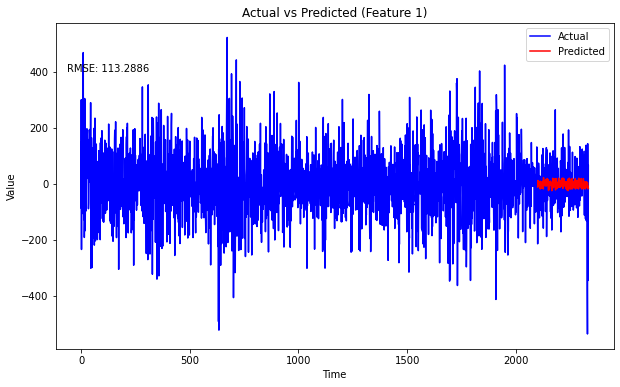

RMSE: 113.2886


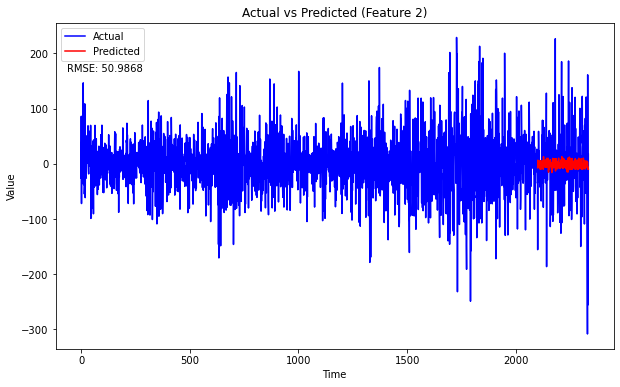

RMSE: 50.9868


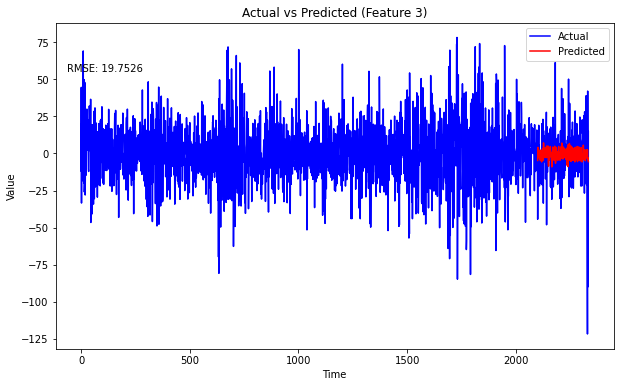

RMSE: 19.7526


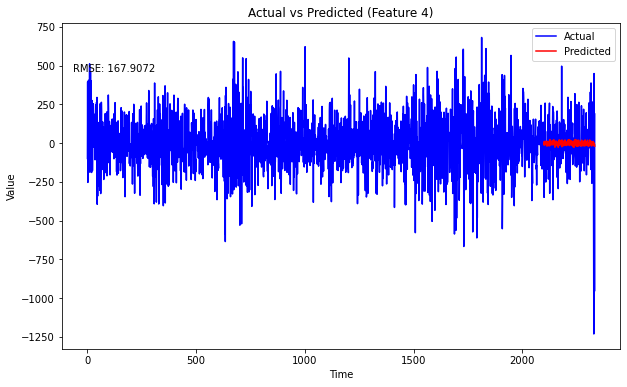

RMSE: 167.9072


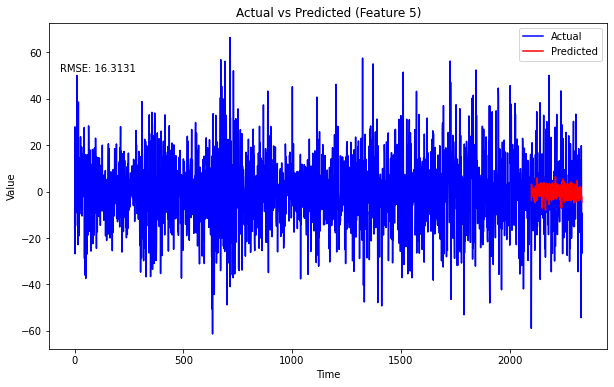

RMSE: 16.3131


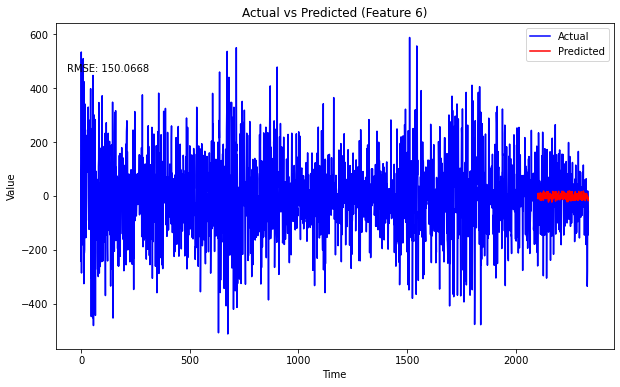

RMSE: 150.0668


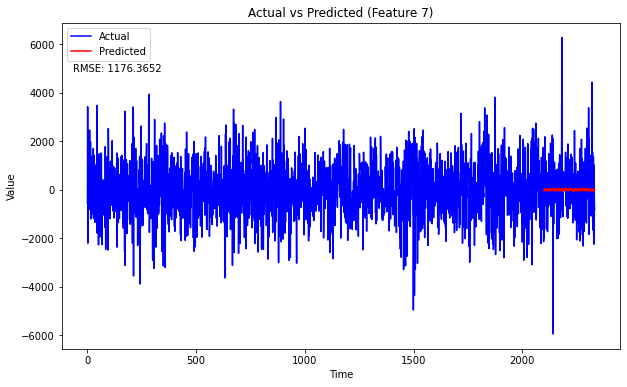

RMSE: 1176.3652


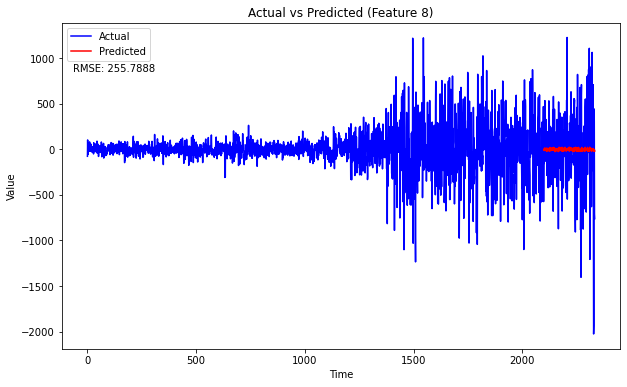

RMSE: 255.7888


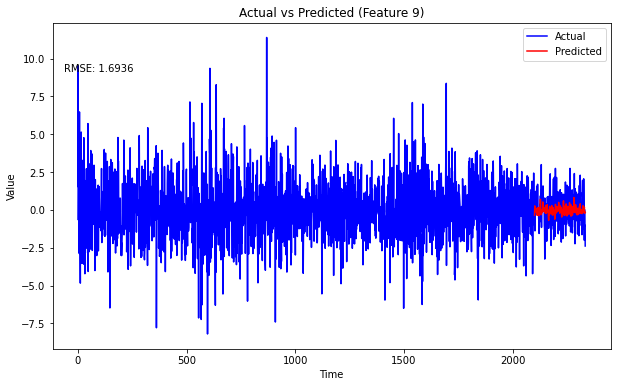

RMSE: 1.6936


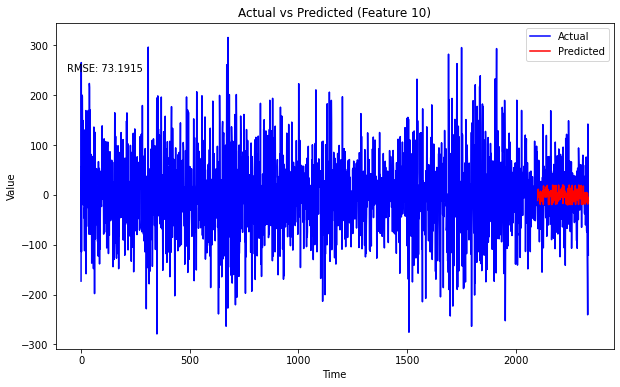

RMSE: 73.1915


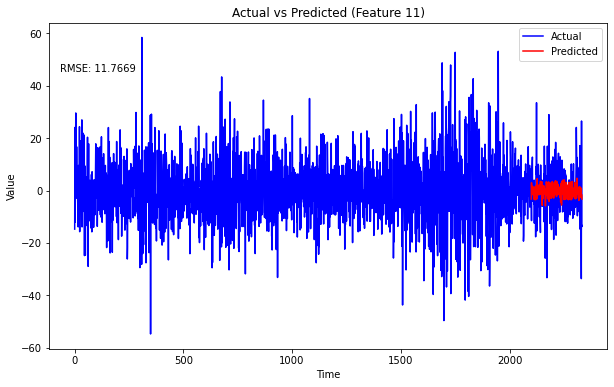

RMSE: 11.7669


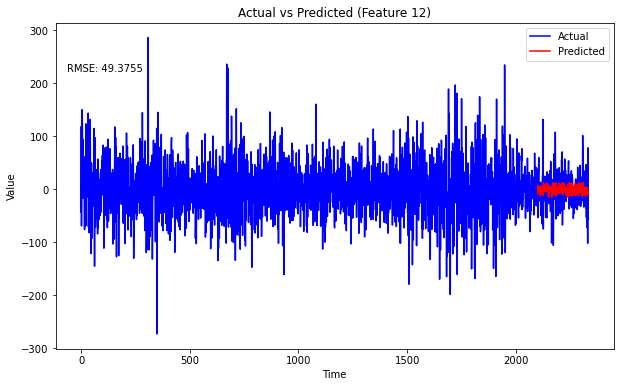

RMSE: 49.3755


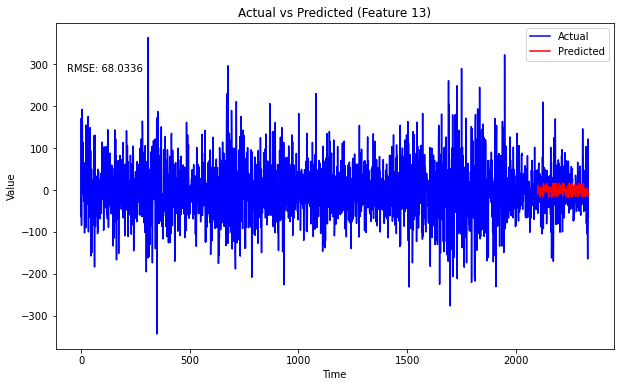

RMSE: 68.0336


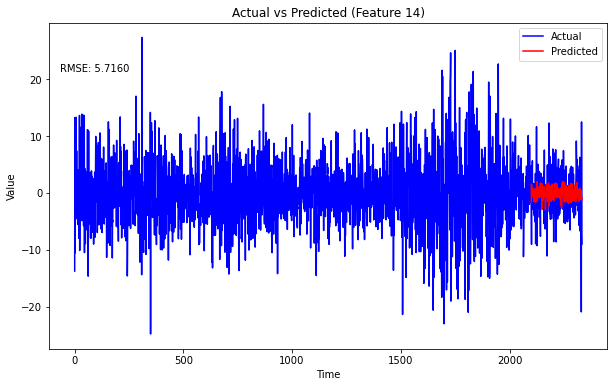

RMSE: 5.7160


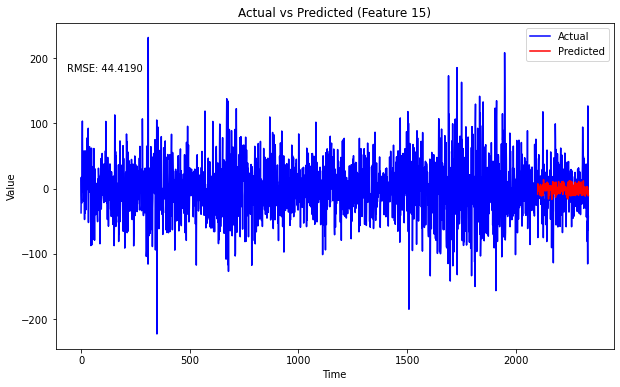

RMSE: 44.4190


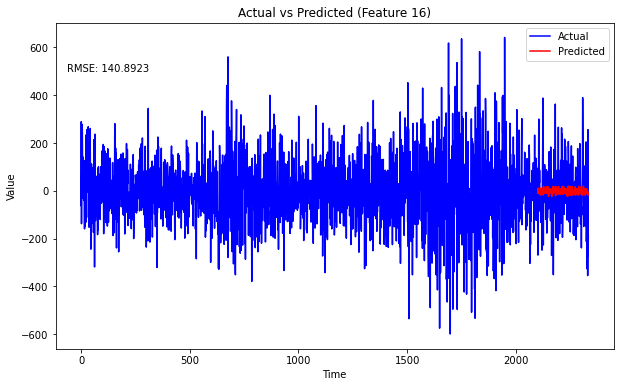

RMSE: 140.8923


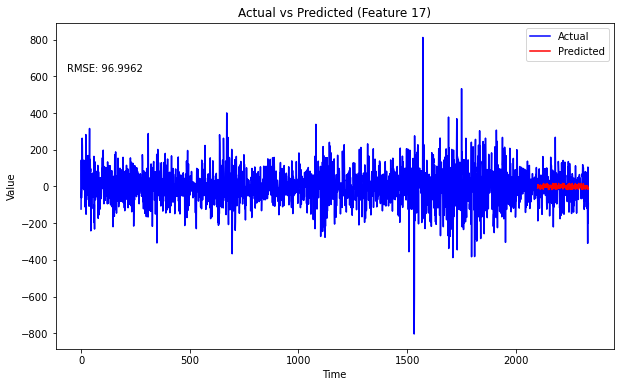

RMSE: 96.9962


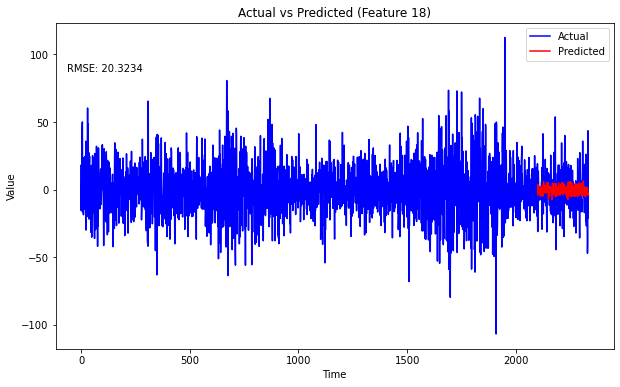

RMSE: 20.3234


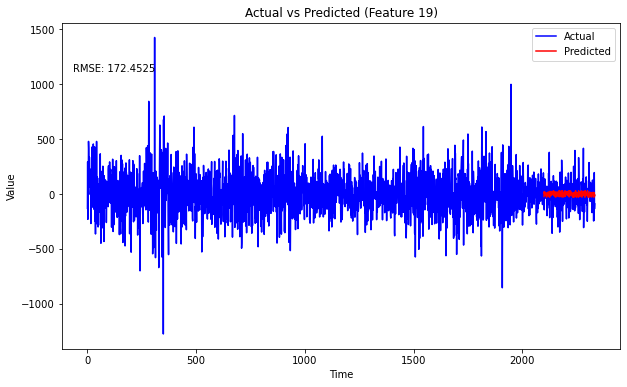

RMSE: 172.4525


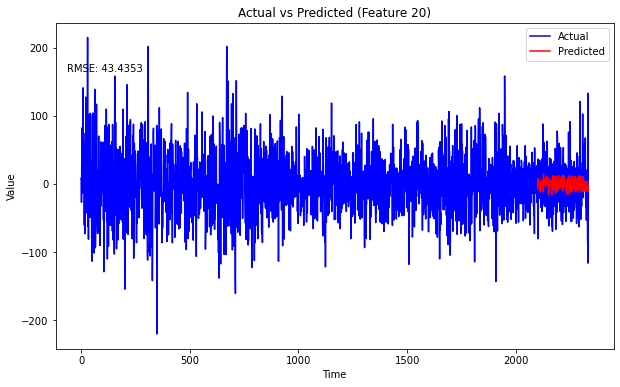

RMSE: 43.4353


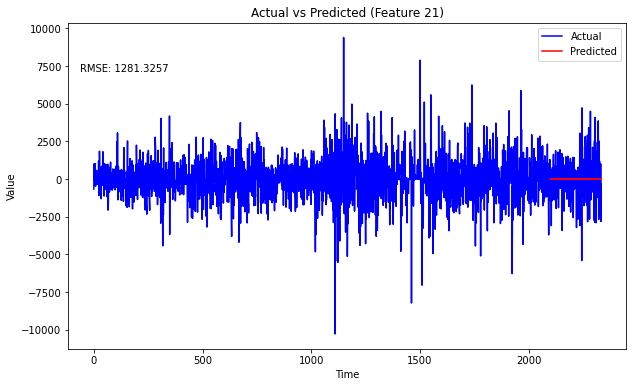

RMSE: 1281.3257


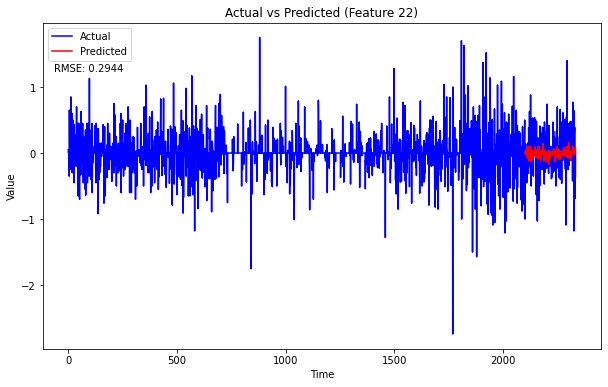

RMSE: 0.2944


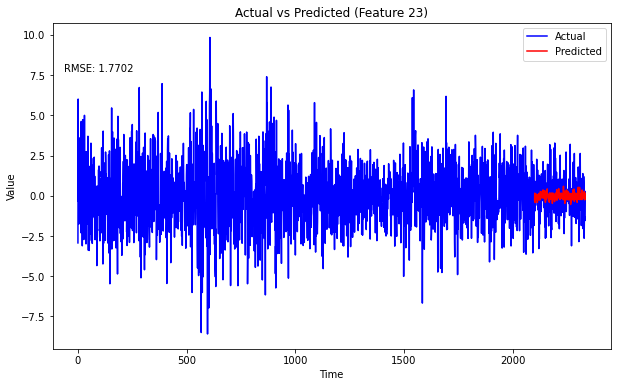

RMSE: 1.7702


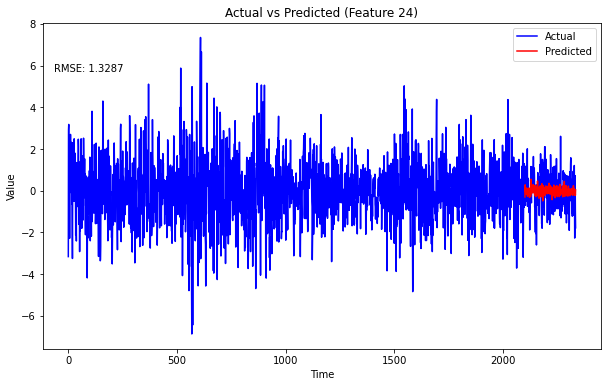

RMSE: 1.3287


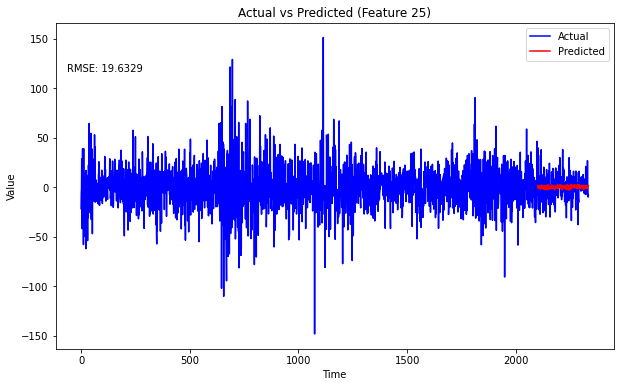

RMSE: 19.6329


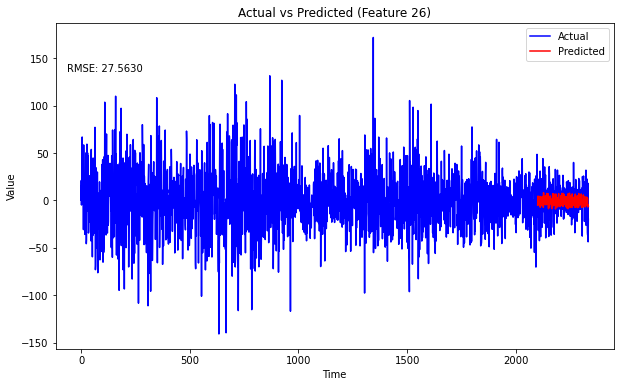

RMSE: 27.5630


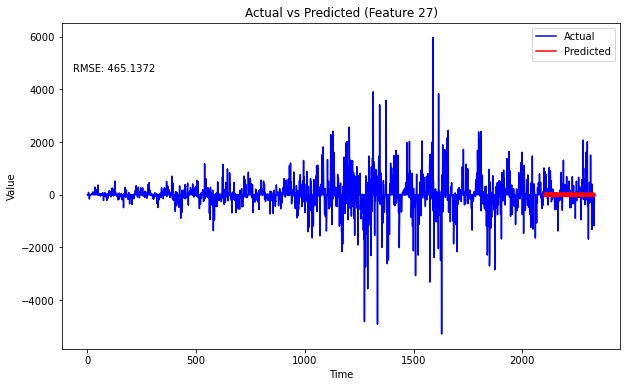

RMSE: 465.1372


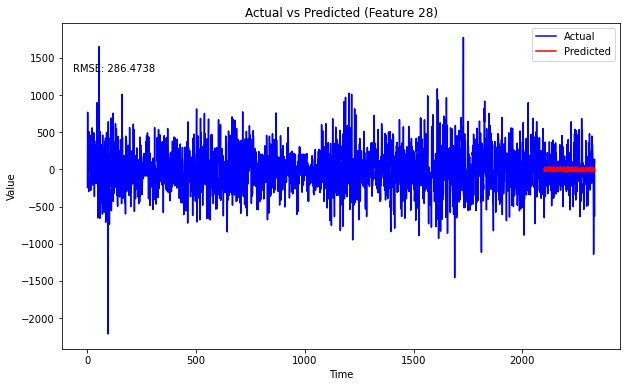

RMSE: 286.4738


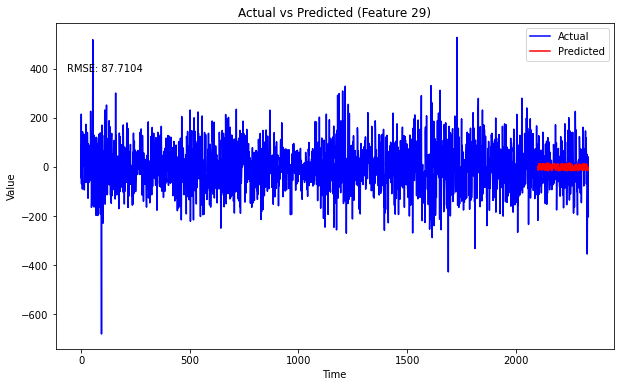

RMSE: 87.7104


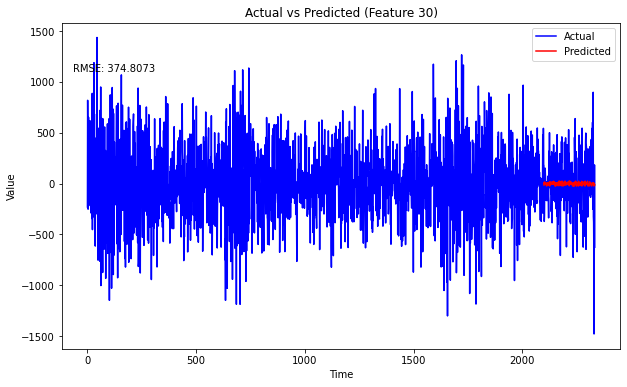

RMSE: 374.8073


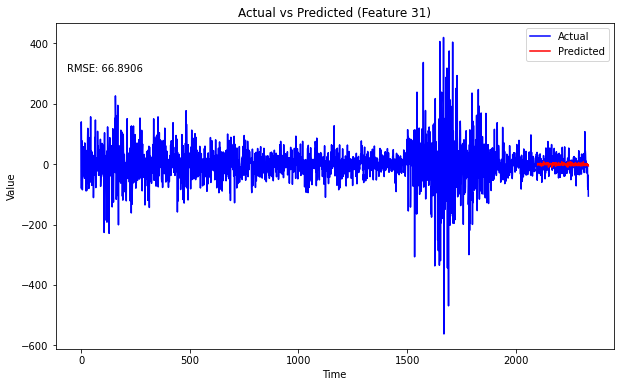

RMSE: 66.8906


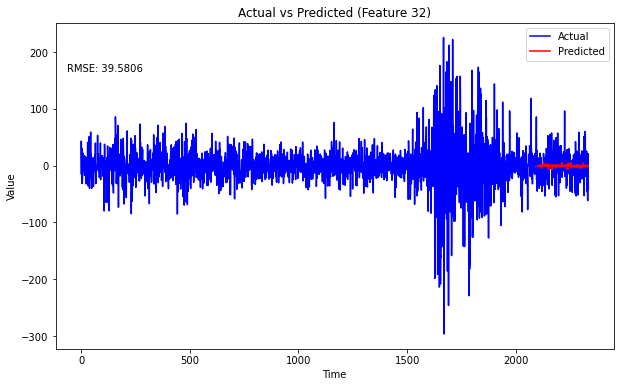

RMSE: 39.5806


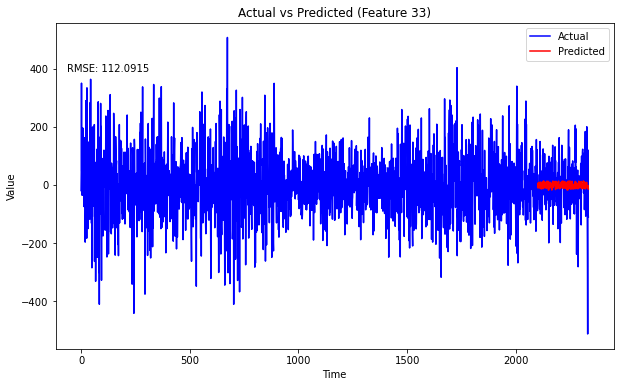

RMSE: 112.0915


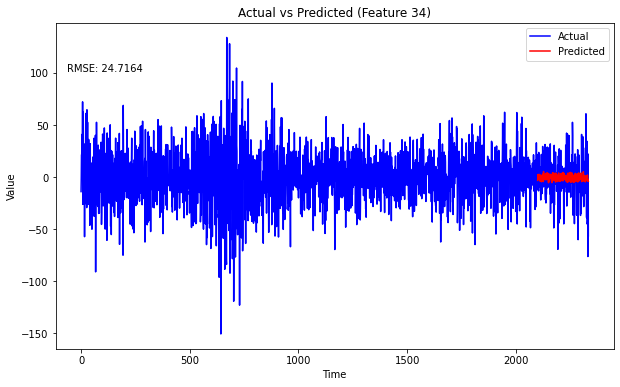

RMSE: 24.7164


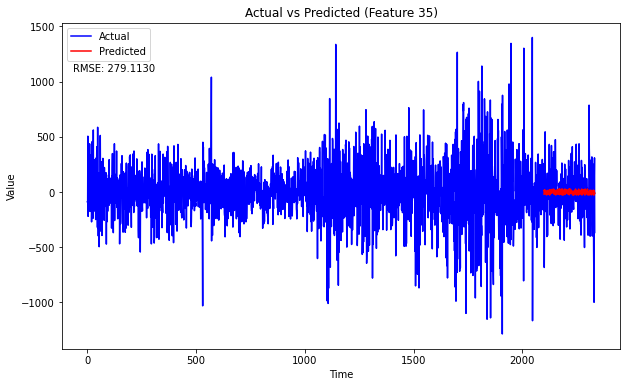

RMSE: 279.1130


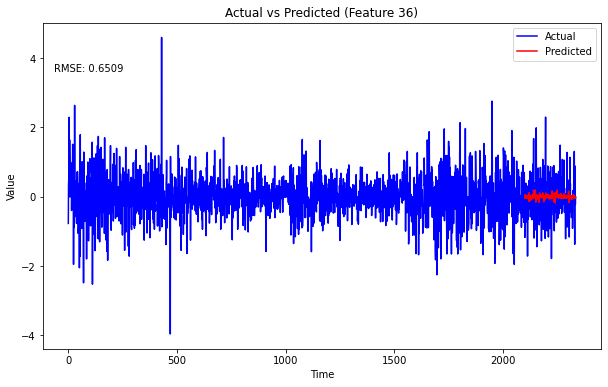

RMSE: 0.6509


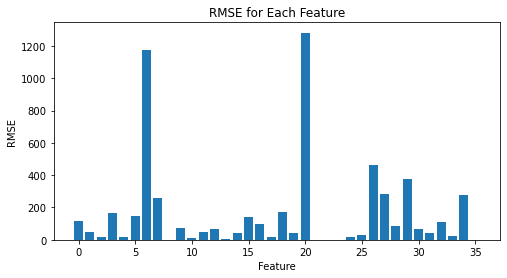

In [106]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from tqdm import tqdm


def split_sequences(sequences):
    X, y = [], []
    for i in range(len(sequences)):
        end_ix = i + 1
        if end_ix > len(sequences) - 1:
            break
        seq_x, seq_y = sequences[i:end_ix], sequences[end_ix]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

dataset = diff_data.to_numpy()

n_features = dataset.shape[1]

X_train_list = []
X_test_list = []
y_train_list = []
y_test_list = []

for i in range(n_features):
    X_i, y_i = split_sequences(dataset[:, i])
    X_train_i, X_test_i, y_train_i, y_test_i = train_test_split(X_i, y_i, test_size=0.1, random_state=42)
    X_train_list.append(X_train_i)
    X_test_list.append(X_test_i)
    y_train_list.append(y_train_i)
    y_test_list.append(y_test_i)

X_train_tensor = torch.Tensor(np.stack(X_train_list, axis=1))
y_train_tensor = torch.Tensor(np.stack(y_train_list, axis=1))
X_test_tensor = torch.Tensor(np.stack(X_test_list, axis=1))
y_test_tensor = torch.Tensor(np.stack(y_test_list, axis=1))

class RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(RNN, self).__init__()
        self.hidden_size = hidden_size
        self.rnn = nn.RNN(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        hidden = torch.zeros(1, x.size(0), self.hidden_size).to(x.device)
        out, _ = self.rnn(x, hidden)
        out = self.fc(out[:, -1, :])
        return out

input_size = X_train_tensor.shape[2]
hidden_size = 64
output_size = y_train_tensor.shape[1]

model = RNN(input_size, hidden_size, output_size)

loss_fn = nn.MSELoss()

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

epochs = 100
progress_bar = tqdm(total=epochs, desc='Training Progress')
for epoch in range(epochs):
    model.train()
    for batch_X, batch_y in train_loader:
        pred_y = model(batch_X)

        loss = loss_fn(pred_y, batch_y)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    progress_bar.update(1)
progress_bar.close()

model.eval()
y_pred = model(X_test_tensor)

y_test_pred = y_pred.detach().numpy()
y_test_np = y_test_tensor.numpy()

rmse_values = []
for i in range(n_features):
    y_pred_i = y_test_pred[:, i]
    y_test_i = y_test_np[:, i]
    rmse = np.sqrt(mean_squared_error(y_test_i, y_pred_i))
    rmse_values.append(rmse)

    x = np.arange(len(dataset))
    plt.figure(figsize=(10, 6))
    plt.plot(x, dataset[:, i], label='Actual', color='blue')
    plt.plot(x[-len(y_pred):], y_pred.detach().numpy()[:, i], label='Predicted', color='red')
    plt.xlabel('Time')
    plt.ylabel('Value')
    plt.title(f'Actual vs Predicted (Feature {i+1})')
    plt.legend()
    plt.text(0.02, 0.85, f'RMSE: {rmse:.4f}', transform=plt.gca().transAxes)
    plt.show()   
    print(f'RMSE: {rmse:.4f}')

plt.figure(figsize=(8, 4))
plt.bar(range(n_features), rmse_values)
plt.xlabel('Feature')
plt.ylabel('RMSE')
plt.title('RMSE for Each Feature')
plt.show()


RNN показала себя лучше всего, она в общем описала движения значений, тем самым сгладив колебания. Метрика получились лучше, чем у CNN.

Обучаем рекурентную нейронную сеть для временных рядов.
n_features = X.shape[2] определяет количество признаков в данных.
Рассчитывается RMSE (корень из среднеквадратической ошибки) для каждого признака в данных.
Для каждого признака строится график, на котором отображаются фактические значения (y_test_i) и предсказанные значения (y_pred_i), а также выводится значение RMSE.
На последнем графике отображается гистограмма RMSE для каждого признака.